# Importing `Libraries`

In [127]:
import sqlite3
import pandas as pd
import re
import requests
import json
import time
import datetime
import pymongo
import matplotlib.pyplot as plt
%matplotlib inline
import pickle

# Connecting to `SQLite` database

In [128]:
conn = sqlite3.connect('database.sqlite')
cur = conn.cursor()

cur.execute("""
            SELECT * FROM Matches 
            WHERE Season = 2011
            """)

df = pd.DataFrame(cur.fetchall())
df.columns = [i[0] for i in cur.description]
df.head()

,Match_ID,Div,Season,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR
0,1092,D1,2011,2012-03-31,Nurnberg,Bayern Munich,0,1,A
1,1093,D1,2011,2011-12-11,Stuttgart,Bayern Munich,1,2,A
2,1094,D1,2011,2011-08-13,Wolfsburg,Bayern Munich,0,1,A
3,1095,D1,2011,2011-11-27,Mainz,Bayern Munich,3,2,H
4,1096,D1,2011,2012-02-18,Freiburg,Bayern Munich,0,0,D


# UPDATE the `DataFrame` USING `API` with `Custom Class` = `WeatherGetter()`

In [210]:
# You don't have to use these classes, but we recommend them as a good place to start!
class WeatherGetter(object):
    """Return an updated DataFrame when passing in a list of dates 
    Using a specific DataFrame, and API key
    Powered by Dark Sky - https://darksky.net/poweredby/
    """
    def __init__(self, dates = [], data = pd.DataFrame(), key = ''):
        """
        dates: list of dates from the dataframe - list type
        data: dataFrame object with dates - DataFrame type
        key: API key for DARK SKY API - str type
        converted_dates: auto converted dates - list type
        forecast: forecast pulled from berlin for each date - list type
        
        """
        self.dates = dates
        self.converted_dates = []
        self.forecast = []
        self.data = data
        self.key = key
        
        # Converting Dates
        for day in self.dates:
            self.converted_dates.append(int(time.mktime(datetime.datetime.strptime(day, "%Y-%m-%d").timetuple())))
        
        # API request for weather on each date
        for date in self.converted_dates:
            base_url = 'https://api.darksky.net/forecast/'
            key = self.key
            lat_long = '52.5200,13.4050'+','
            base_url = 'https://api.darksky.net/forecast/'
            url = base_url + key + "/" + lat_long + str(date)
            response = requests.get(url)
            data = response.json()
            if response.status_code == requests.codes.ok:
                icon = data['daily']['data'][0]['icon']
                self.forecast.append(icon)
            else:
                print('Connection Error')
                break 
        if len(self.forecast) == len(self.data):
            self.data['Forecast'] = self.forecast
        else:
            pass

### Instantiating `WeatherGetter()`

In [211]:
def get_keys(path):
    """Get's API key from local path"""
    with open(path) as f:
        return json.load(f)
keys = get_keys("/Users/jacobtadesse/.secret/dark_sky.json")

api_key = keys['api_key']

In [131]:
Dates = list(df.Date)
init = WeatherGetter(dates = Dates, data = df, key = api_key)
init.data

,Match_ID,Div,Season,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,Forecast
0,1092,D1,2011,2012-03-31,Nurnberg,Bayern Munich,0,1,A,rain
1,1093,D1,2011,2011-12-11,Stuttgart,Bayern Munich,1,2,A,partly-cloudy-day
2,1094,D1,2011,2011-08-13,Wolfsburg,Bayern Munich,0,1,A,partly-cloudy-day
3,1095,D1,2011,2011-11-27,Mainz,Bayern Munich,3,2,H,partly-cloudy-day
4,1096,D1,2011,2012-02-18,Freiburg,Bayern Munich,0,0,D,partly-cloudy-day
5,1097,D1,2011,2012-01-20,M'gladbach,Bayern Munich,3,1,H,rain
6,1098,D1,2011,2012-02-04,Hamburg,Bayern Munich,1,1,D,partly-cloudy-day
7,1099,D1,2011,2012-04-21,Werder Bremen,Bayern Munich,1,2,A,partly-cloudy-day
8,1100,D1,2011,2011-09-18,Schalke 04,Bayern Munich,0,2,A,rain
9,1101,D1,2011,2011-10-23,Hannover,Bayern Munich,2,1,H,rain


# USING a `FOR LOOP` to create a new `DataFrame` (df2)

In [132]:
teams = []
goals = []
wins = []
losses = []
draws = []
games = []
win_percent = []
percentage = []

for team in df['HomeTeam'].unique():
    ## Team Name
    teams.append(team)

    ## Team Goals
    goals_H = df['FTHG'][df['HomeTeam']==team].sum()
    goals_A = df['FTAG'][df['AwayTeam']==team].sum()
    goals.append(goals_H + goals_A)

    ## Team Wins
    wins_H = df[(df['HomeTeam']==team) & (df['FTR']=='H')]
    wins_A = df[(df['AwayTeam']==team) & (df['FTR']=='A')]
    tot_wins = len(wins_H) + len(wins_A)
    wins.append(tot_wins)

    ## Team Losses
    loss_H = df[(df['HomeTeam']==team) & (df['FTR']=='A')]
    loss_A = df[(df['AwayTeam']==team) & (df['FTR']=='H')]
    tot_lossess = len(loss_H) + len(loss_A)
    losses.append(tot_lossess)

    ## Team Draws
    draw_H = df[(df['HomeTeam']==team) & (df['FTR']=='D')]
    draw_A = df[(df['AwayTeam']==team) & (df['FTR']=='D')]
    draws.append(len(draw_H) + len(draw_A))
        
    ## Total Games
    tot_games = len(wins_H) + len(loss_H) + len(draw_H)
    games.append(tot_games)

    ## Win percentage on days where it was raining during games 
    rain_wins_H = df[(df['HomeTeam']==team) & (df['FTR']=='H') & (df['Forecast']=='rain')]
    rain_wins_A = df[(df['AwayTeam']==team) & (df['FTR']=='A') & (df['Forecast']=='rain')]
    tot_wins_in_rain = len(rain_wins_H) + len(rain_wins_A)
    percent_of_wins = tot_wins_in_rain / tot_games
    win_percent.append(round(percent_of_wins, 2))
    
    ## Rain Wins as a percent
    
    rain_wins = percent_of_wins * 100
    percent = "{}%".format(round(rain_wins,2))
    percentage.append(percent)
    
    
    
df2 = pd.DataFrame()
df2['Team'] = teams
df2['Goals'] = goals
df2['Wins'] = wins
df2['Losses'] = losses
df2['Draws'] = draws
df2['Total Games'] = games
df2['Wins in Rain'] = win_percent
df2['Rain Win Percentage'] = percentage
df2.head(10)

,Team,Goals,Wins,Losses,Draws,Total Games,Wins in Rain,Rain Win Percentage
0,Nurnberg,38,12,16,6,17,0.29,29.41%
1,Stuttgart,63,15,11,8,17,0.18,17.65%
2,Wolfsburg,47,13,16,5,17,0.24,23.53%
3,Mainz,47,9,13,12,17,0.12,11.76%
4,Freiburg,45,10,14,10,17,0.18,17.65%
5,M'gladbach,49,17,8,9,17,0.47,47.06%
6,Hamburg,35,8,14,12,17,0.12,11.76%
7,Werder Bremen,49,11,14,9,17,0.29,29.41%
8,Schalke 04,74,20,10,4,17,0.29,29.41%
9,Hannover,41,12,10,12,17,0.29,29.41%


# Adding Win/Loss Graphs for Each Team & Saving Pickle Images

<IPython.core.display.Javascript object>


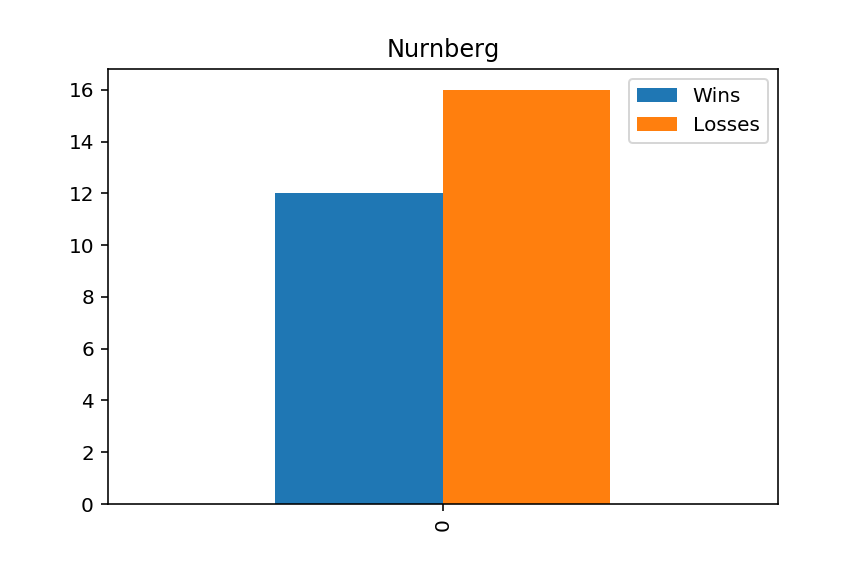

b'\x80\x04\x95\x03\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


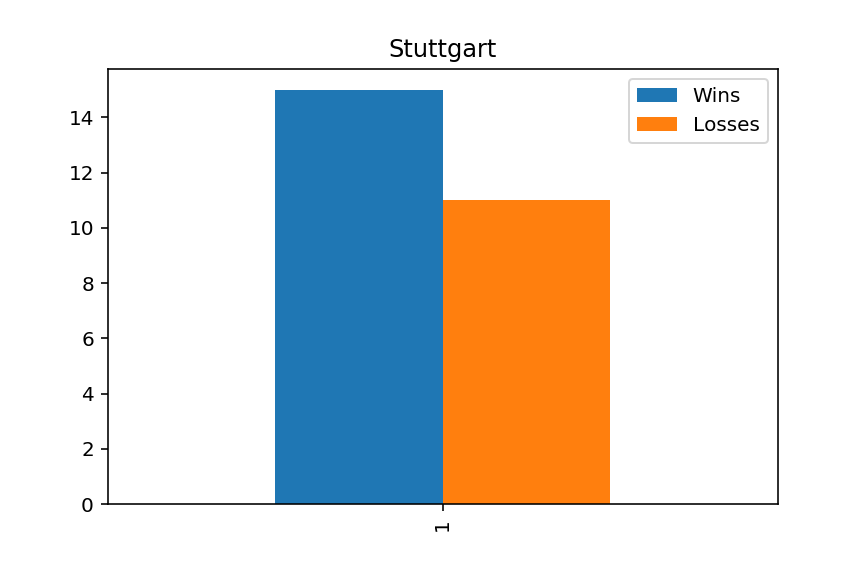

b'\x80\x04\x95\x01\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


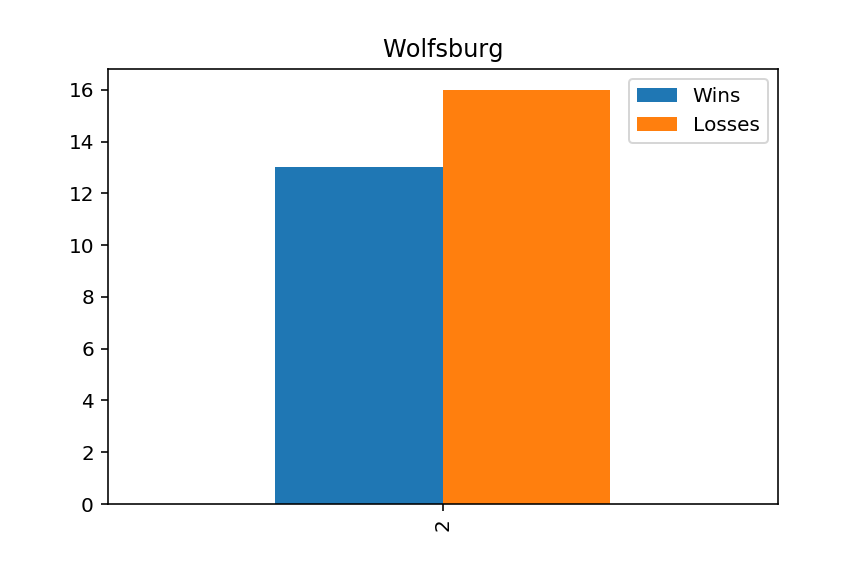

b'\x80\x04\x95\x03\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


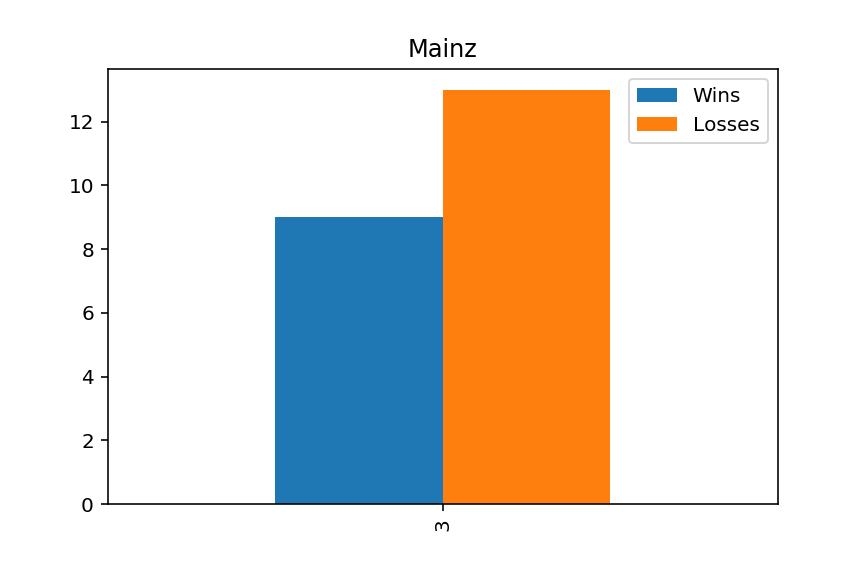

b'\x80\x04\x95\x01\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


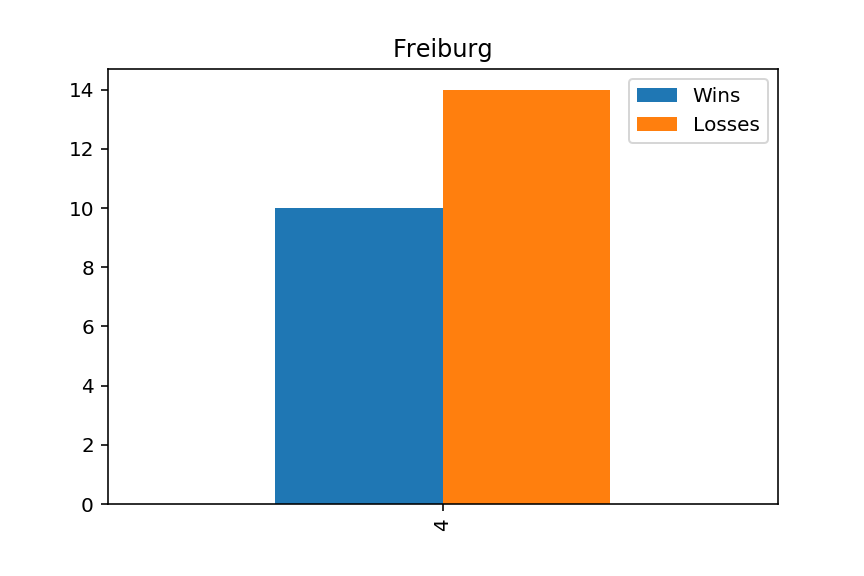

b'\x80\x04\x95\x01\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


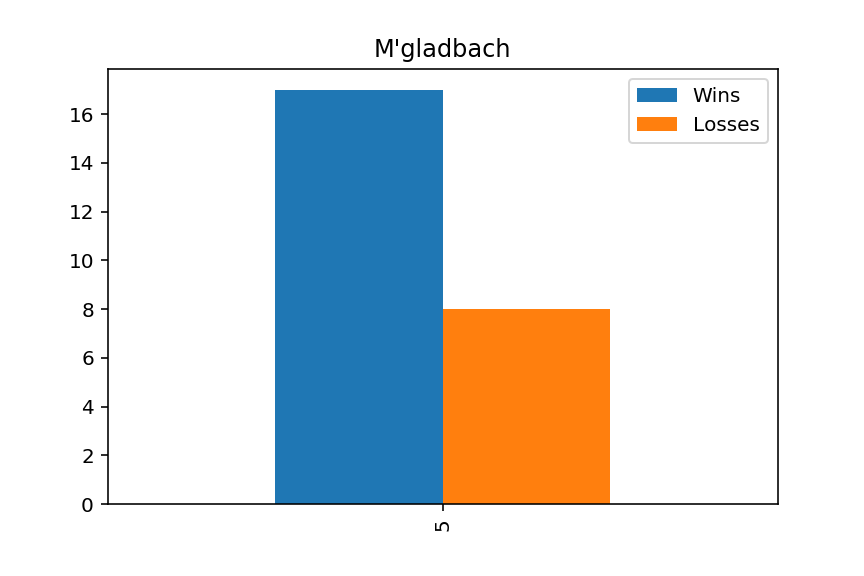

b'\x80\x04\x95\x03\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


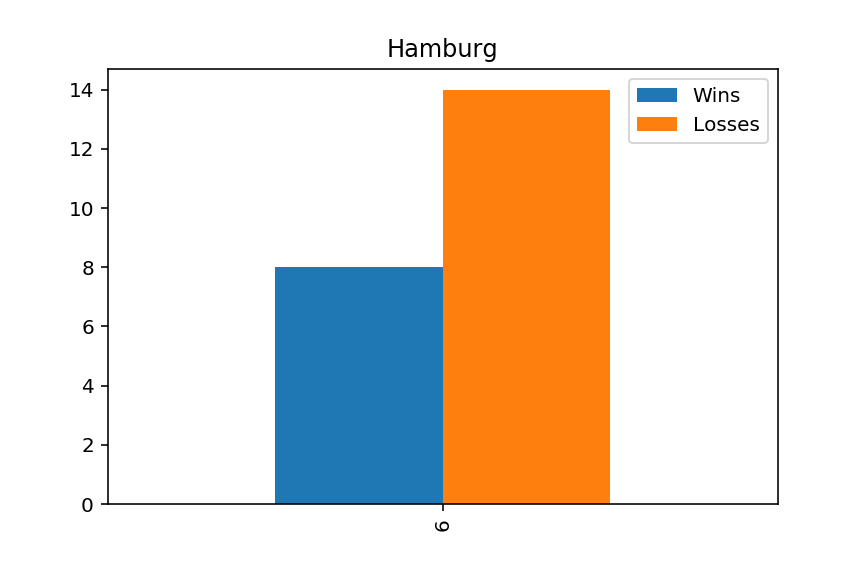

b'\x80\x04\x95\x01\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


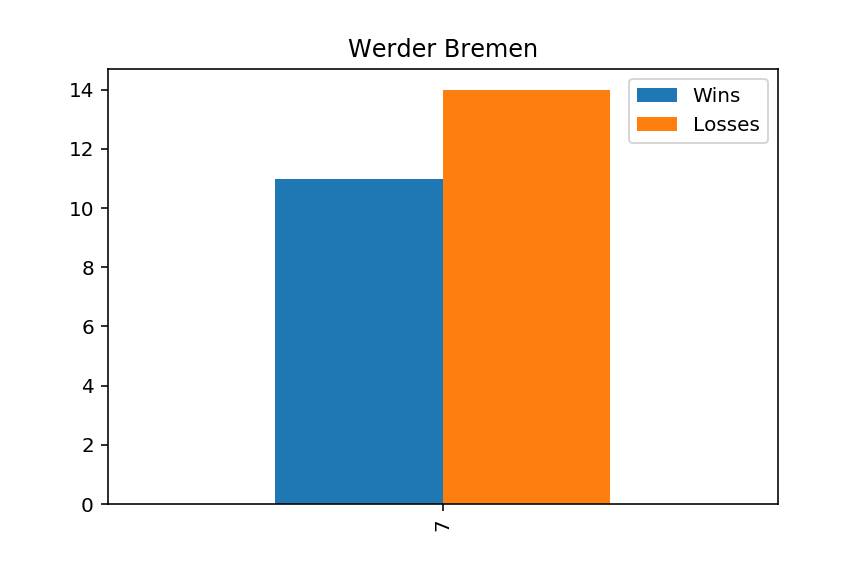

b'\x80\x04\x95\x01\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


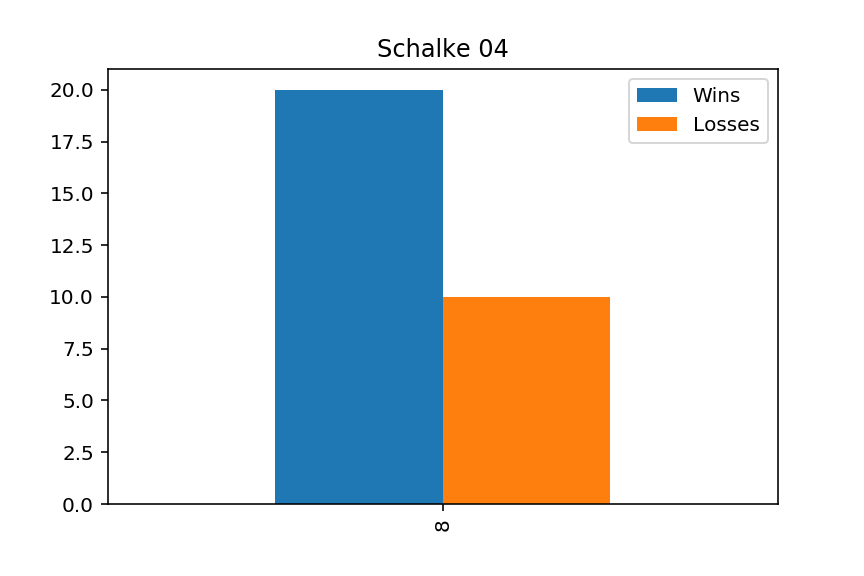

b'\x80\x04\x95\x07\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


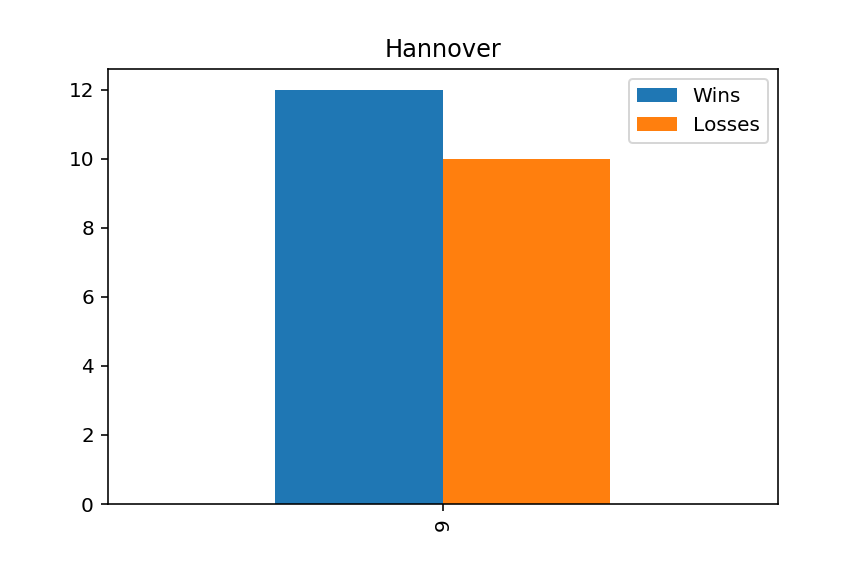

b'\x80\x04\x95\x01\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


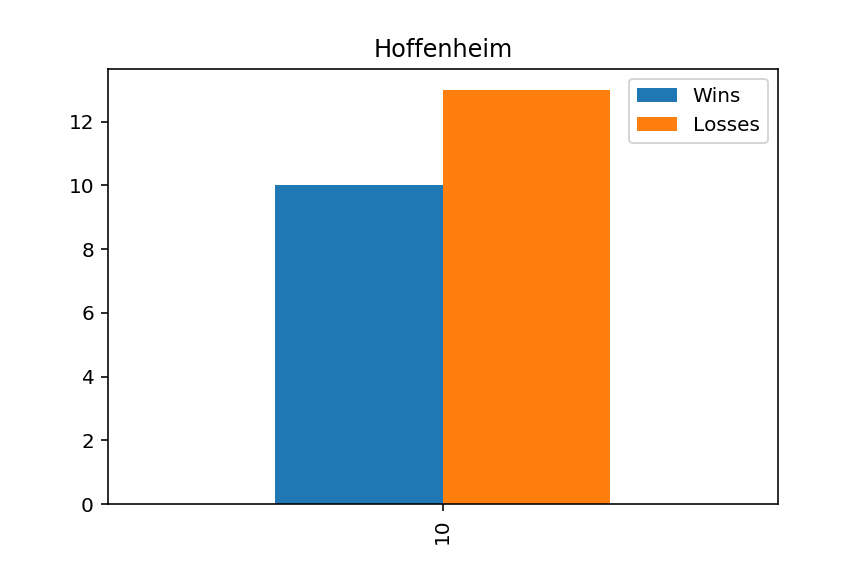

b'\x80\x04\x95\x02\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


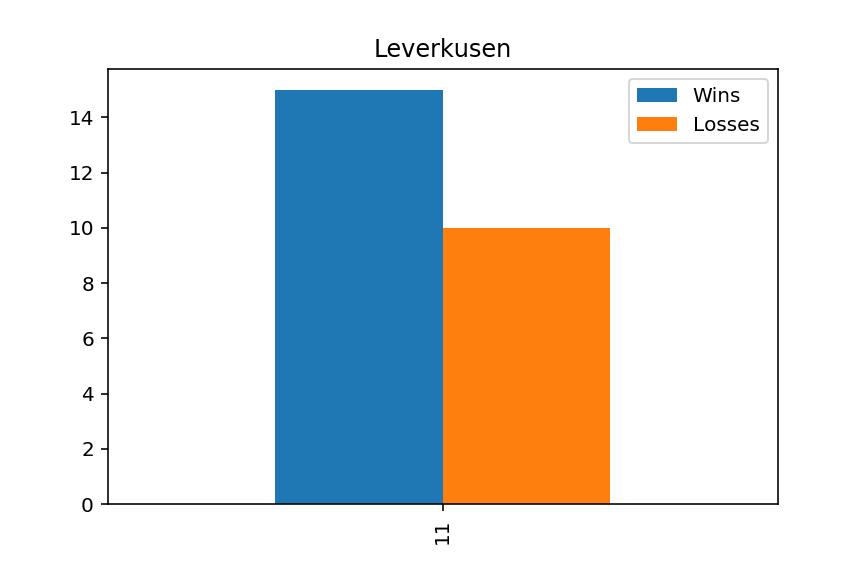

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


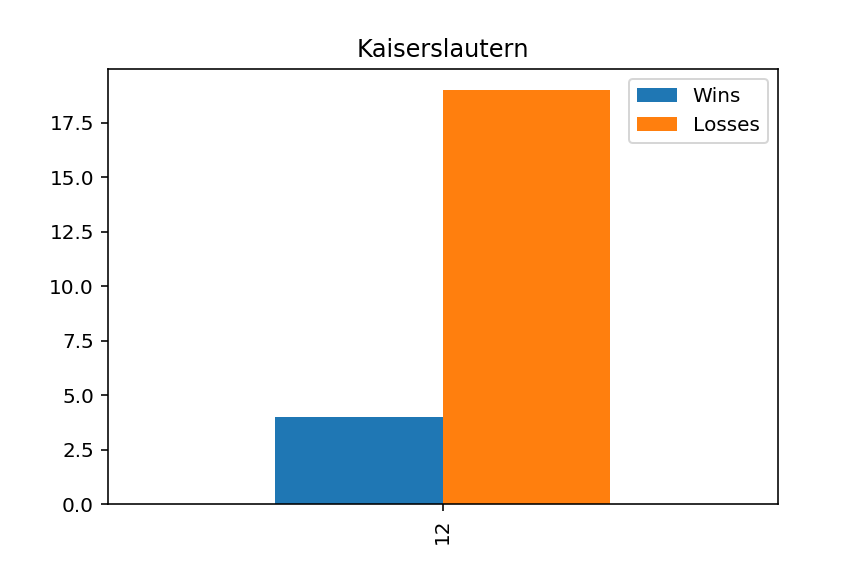

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


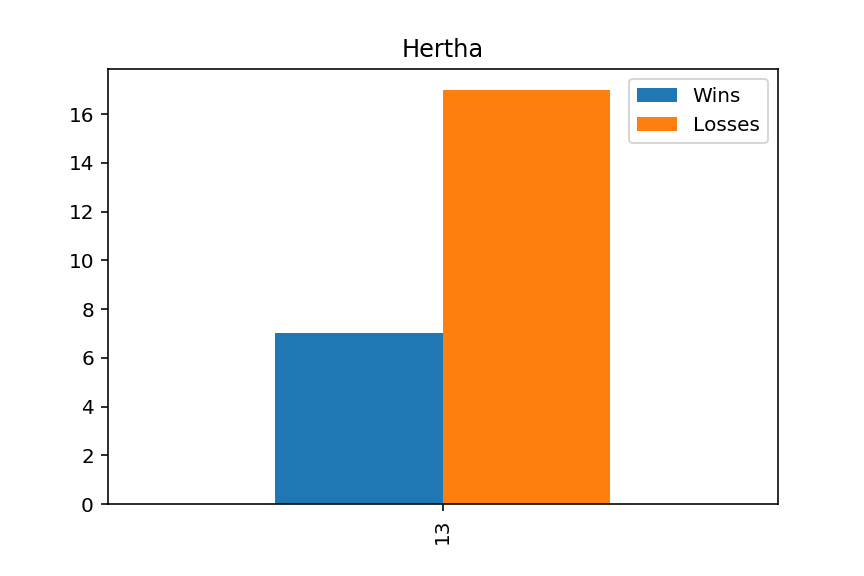

b'\x80\x04\x95\x04\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


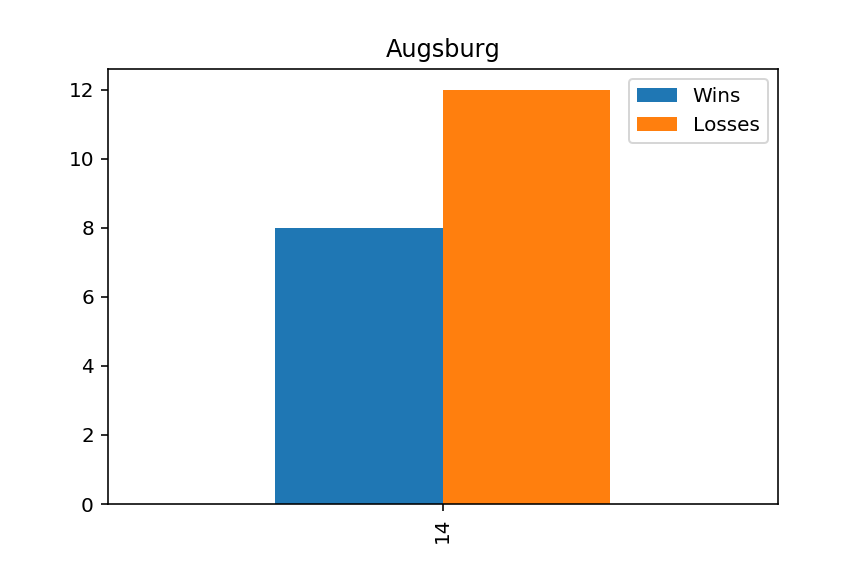

b'\x80\x04\x95\x02\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


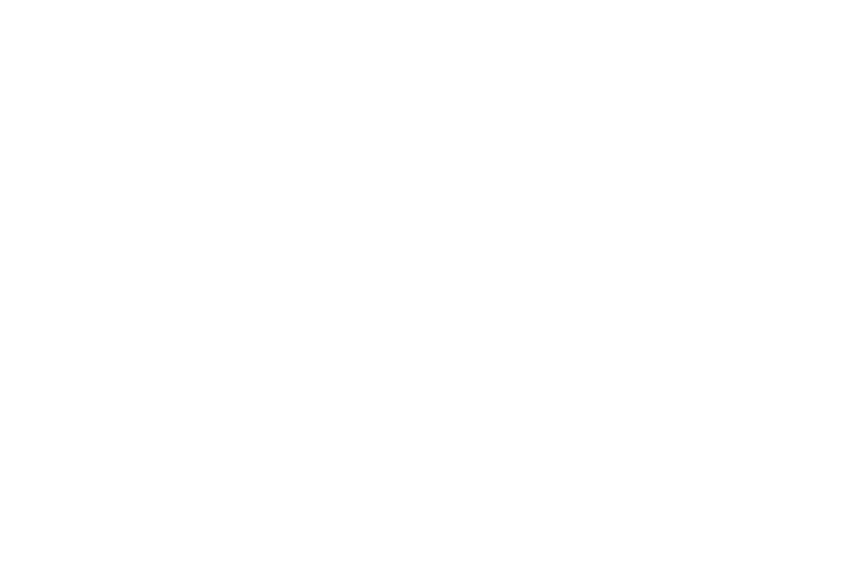

b'\x80\x04\x95\x08\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


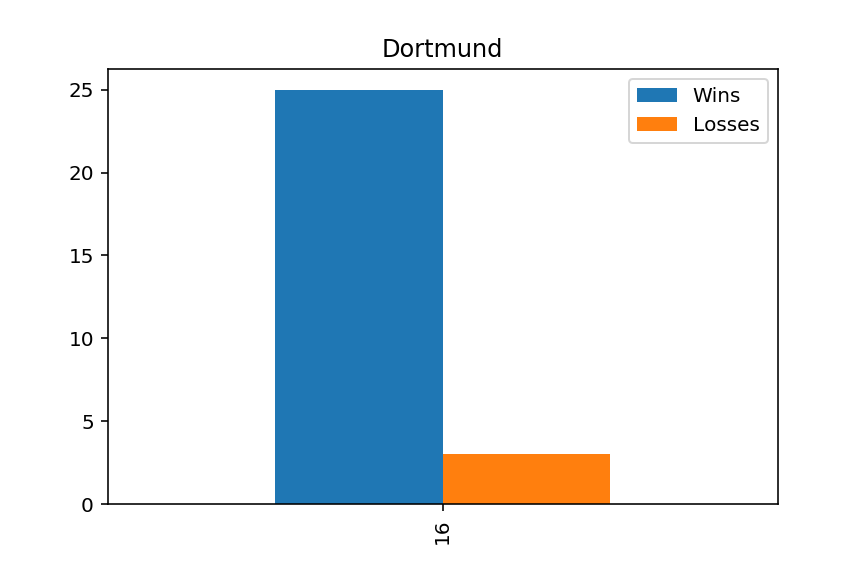

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


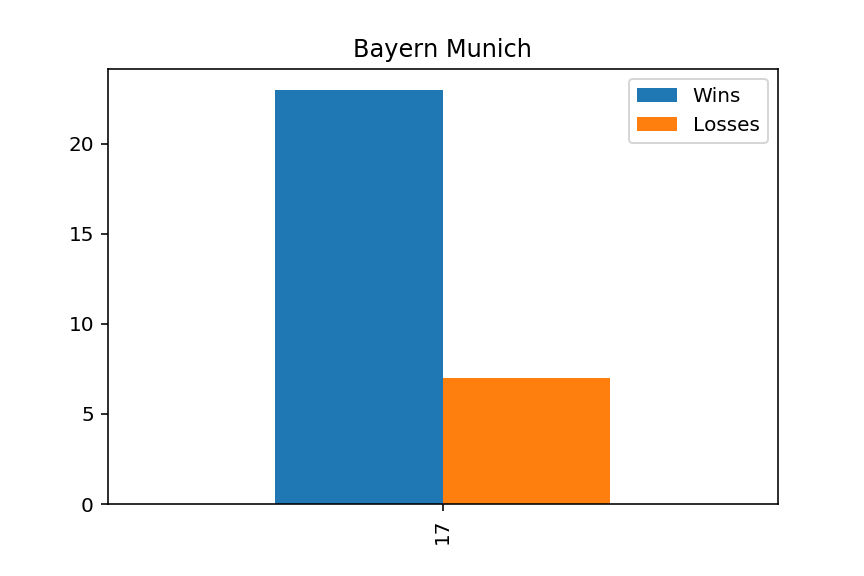

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


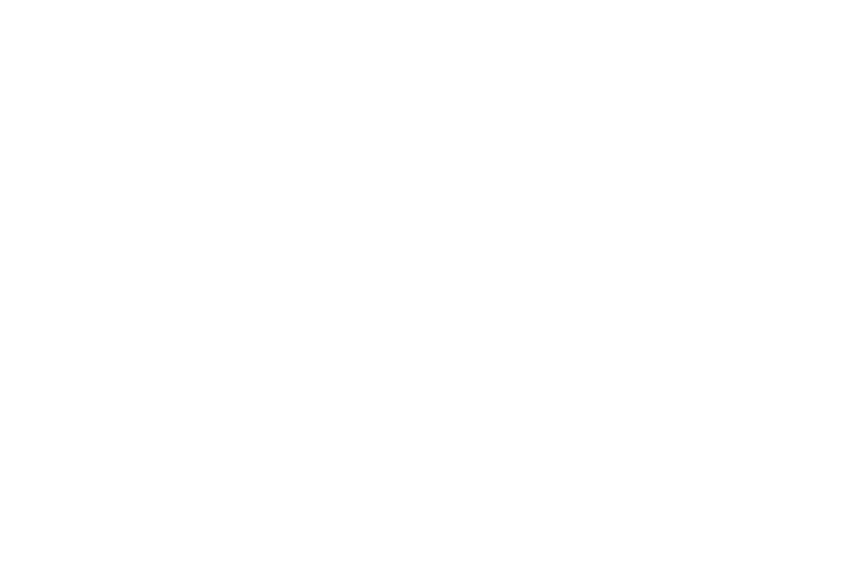

b'\x80\x04\x95\x04\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


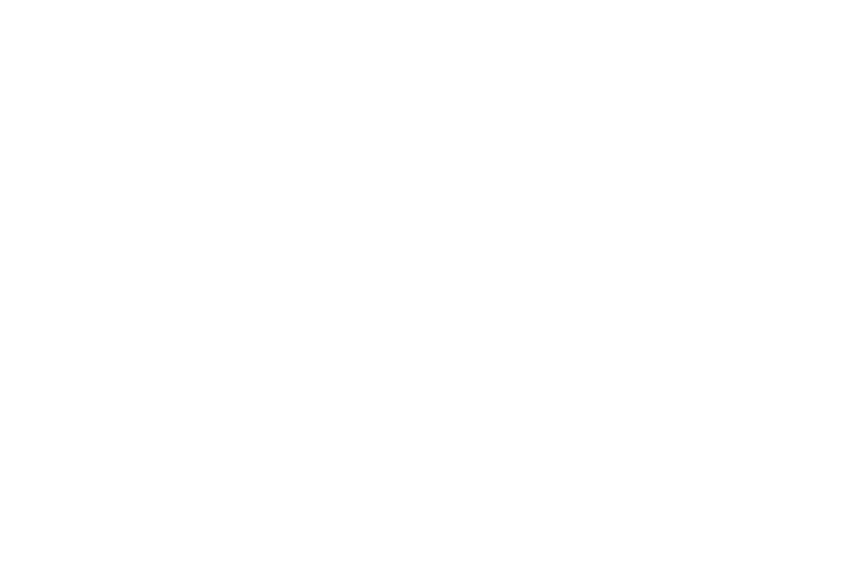

b'\x80\x04\x95\x04\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


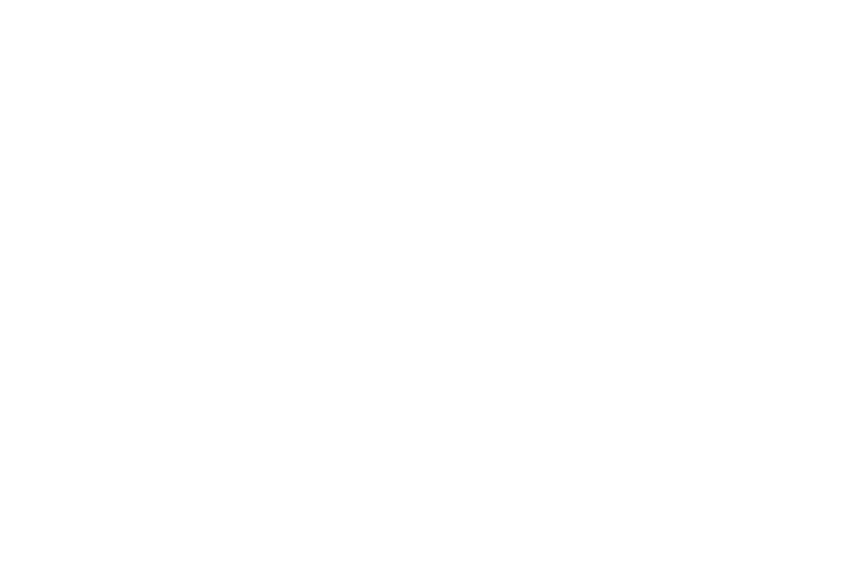

b'\x80\x04\x95\x08\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


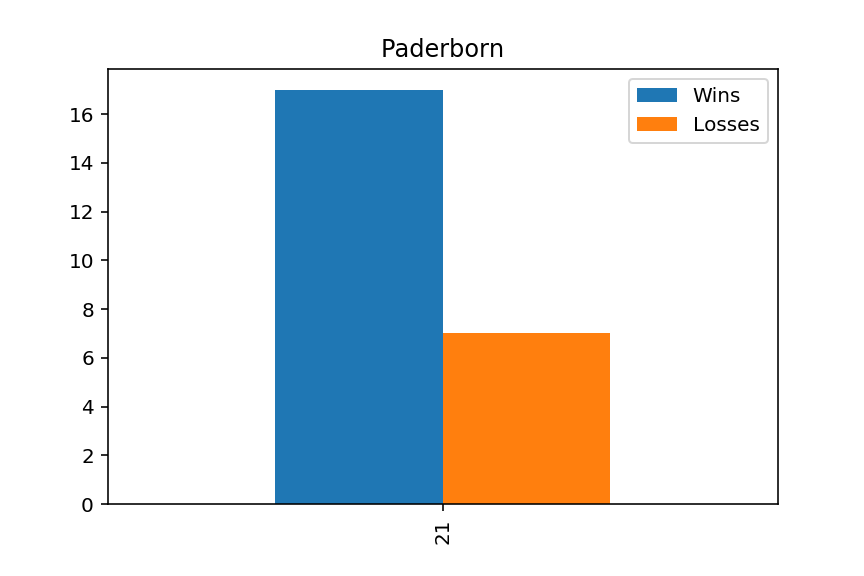

b'\x80\x04\x95\x04\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


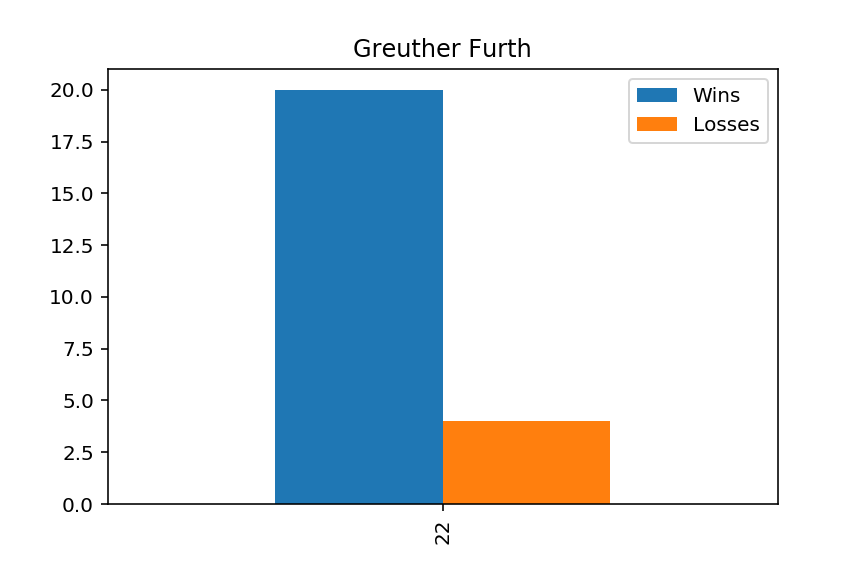

b'\x80\x04\x95\x08\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


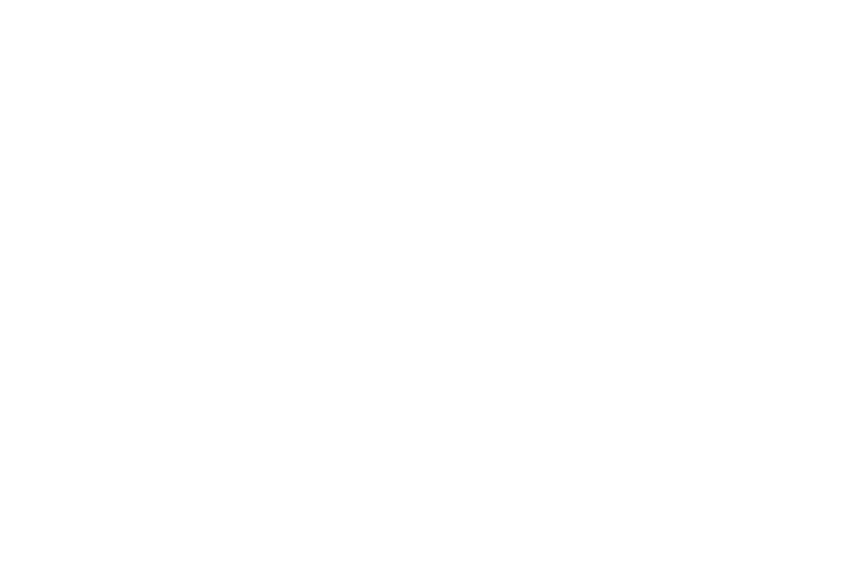

b'\x80\x04\x95\x04\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


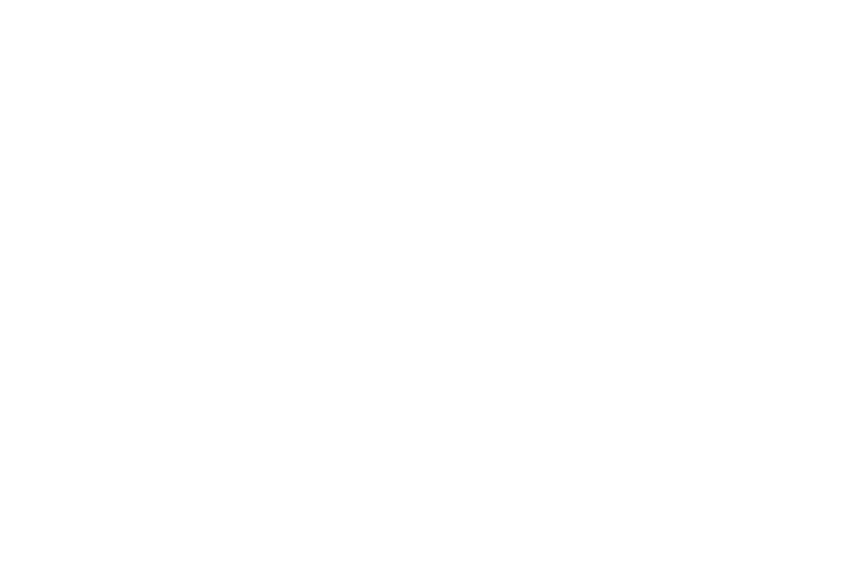

b'\x80\x04\x95\x02\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


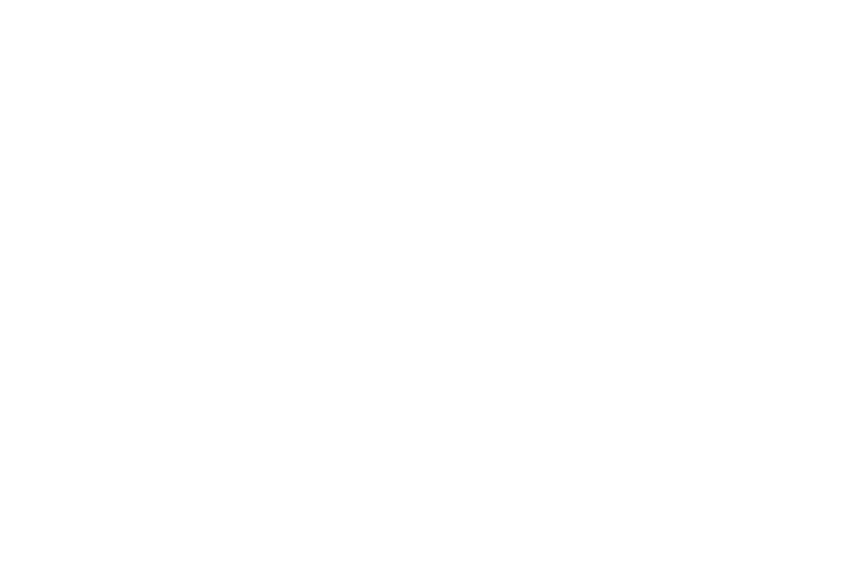

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


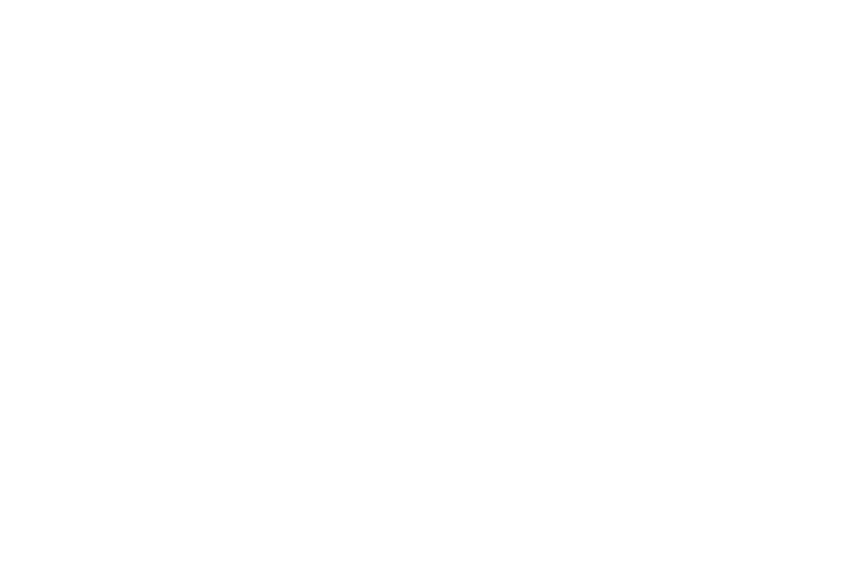

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


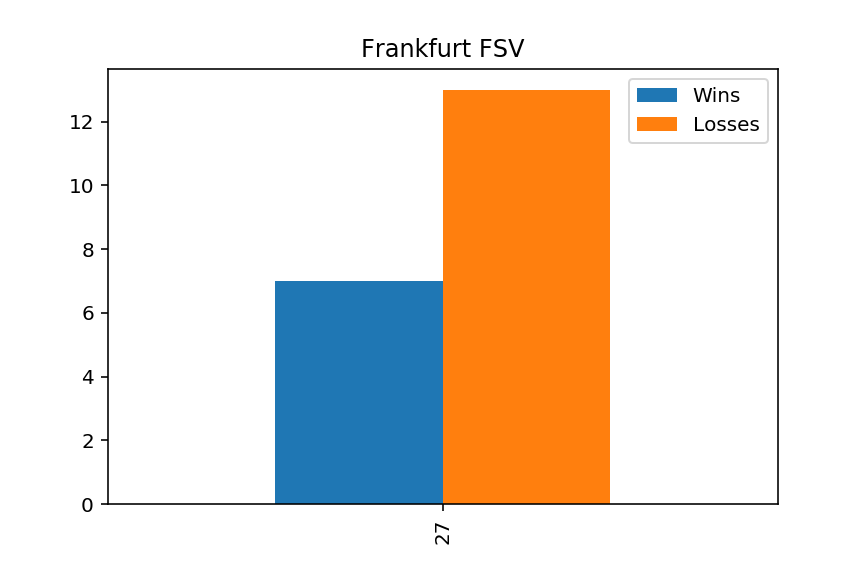

b'\x80\x04\x95\x02\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


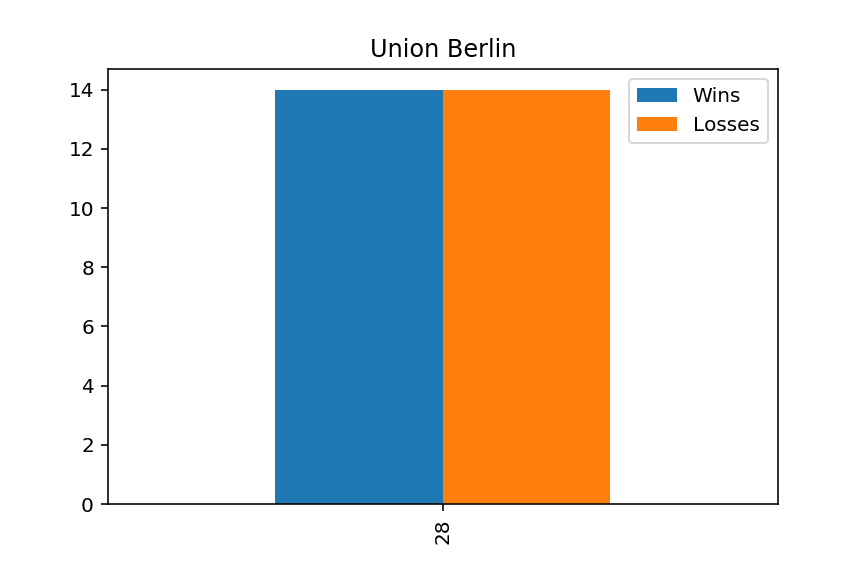

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


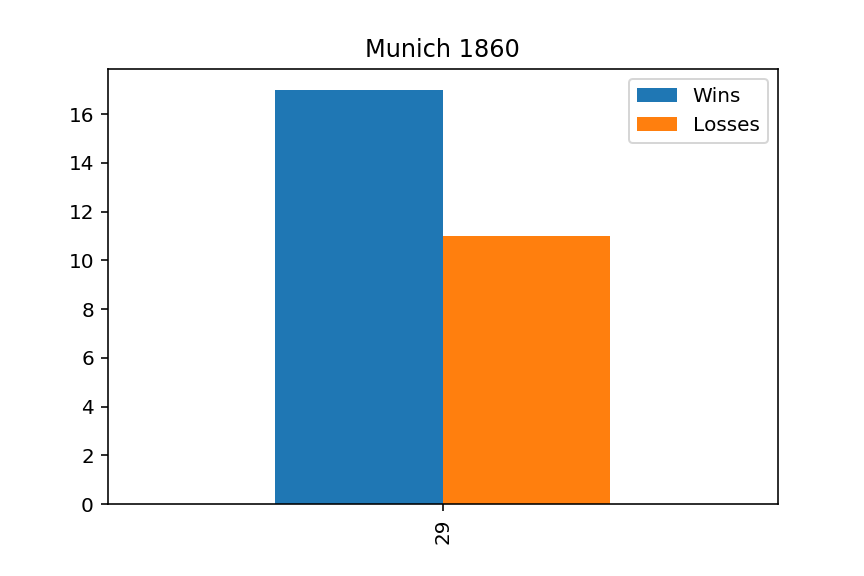

b'\x80\x04\x95\x04\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


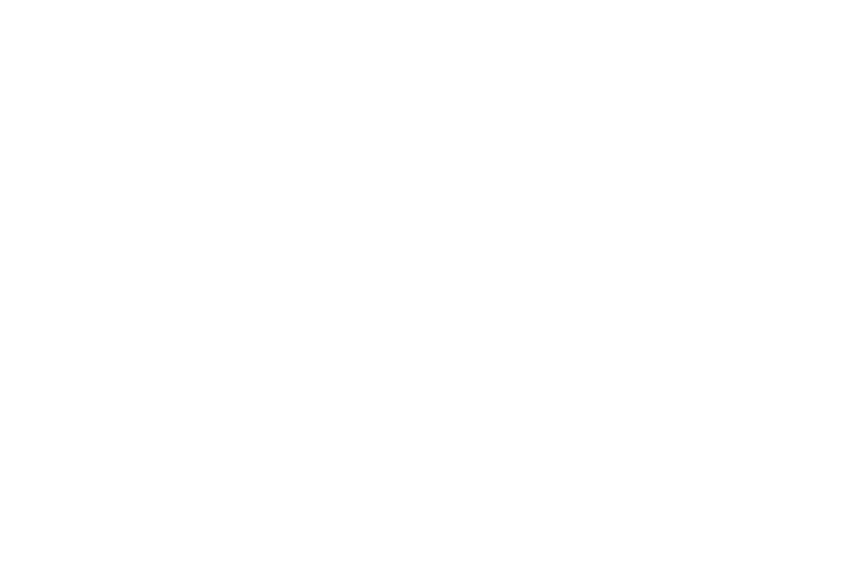

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


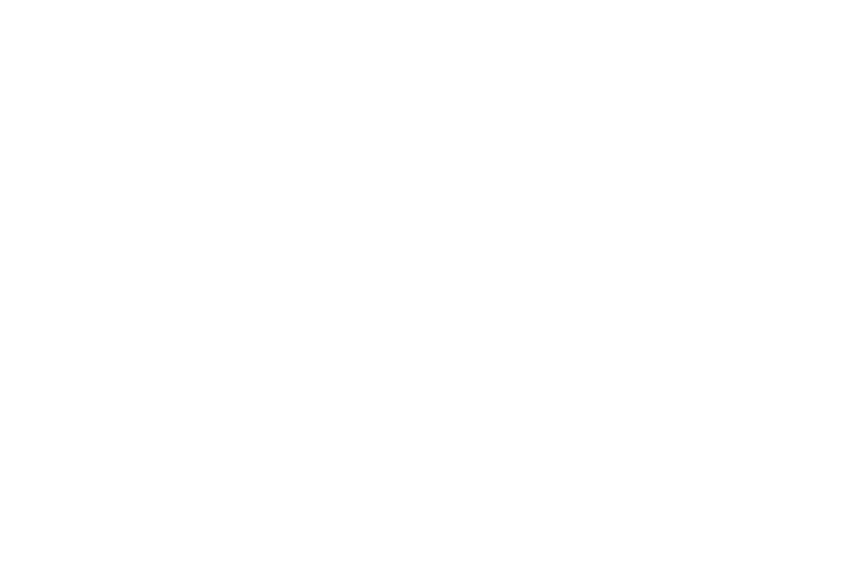

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


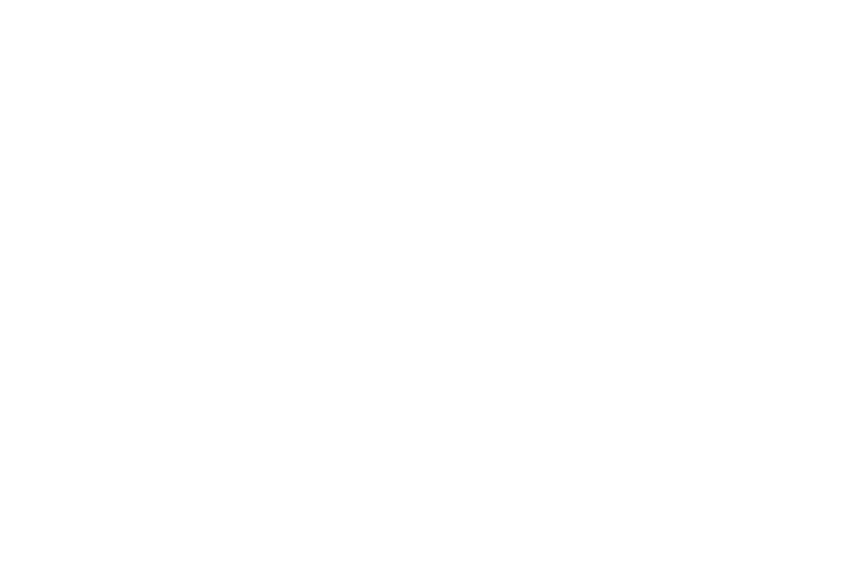

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


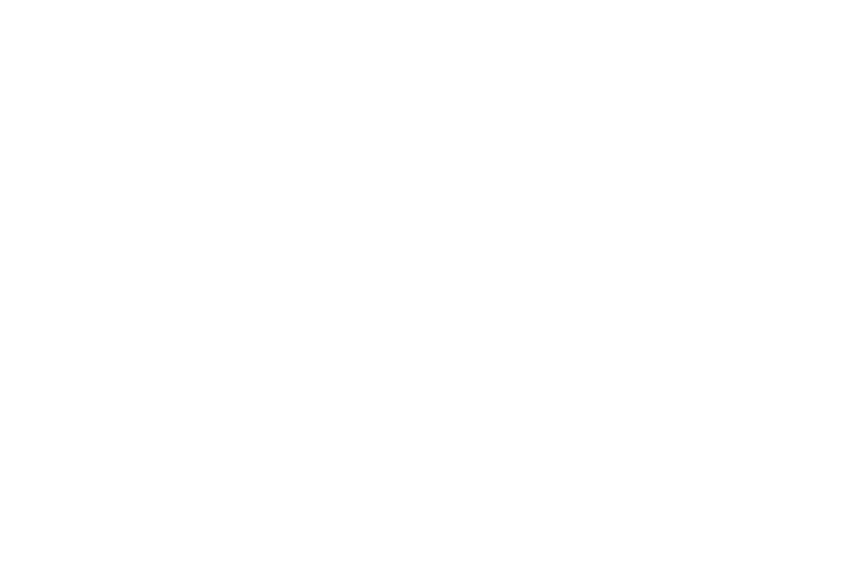

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


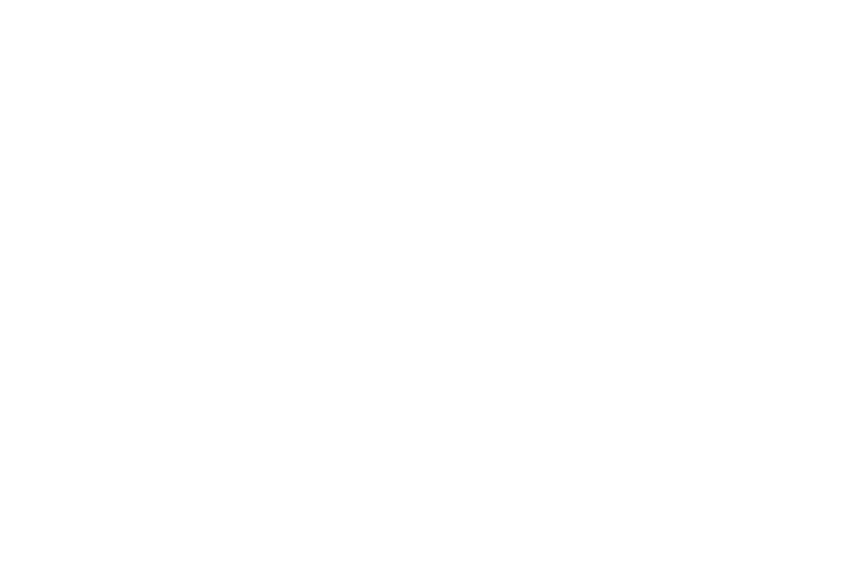

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


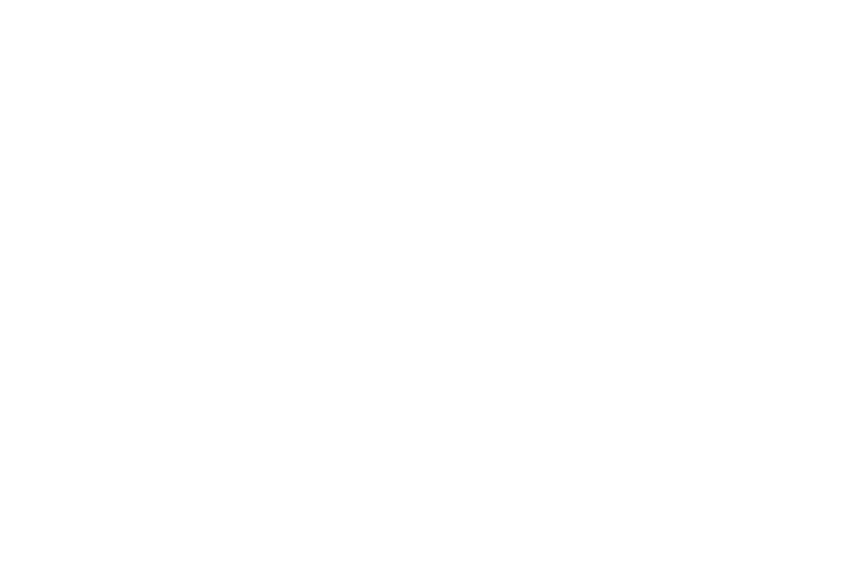

b'\x80\x04\x95\x02\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


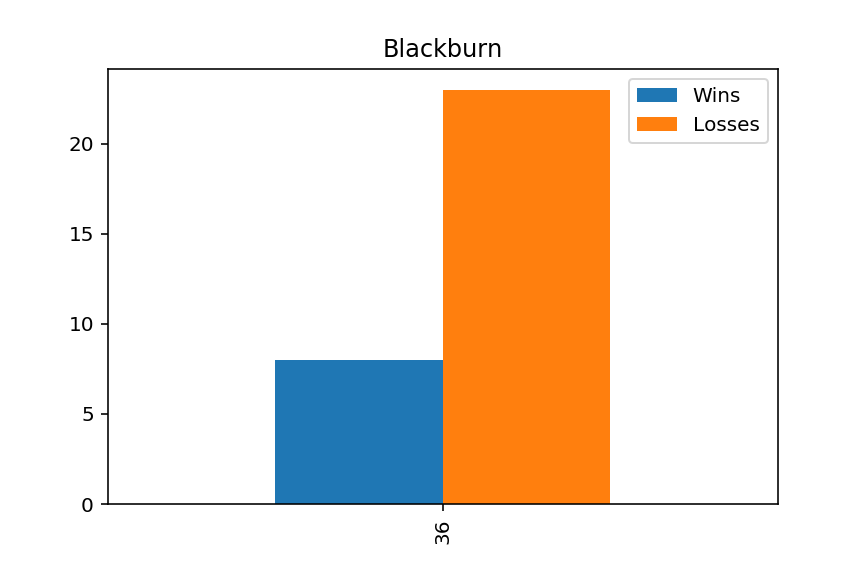

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


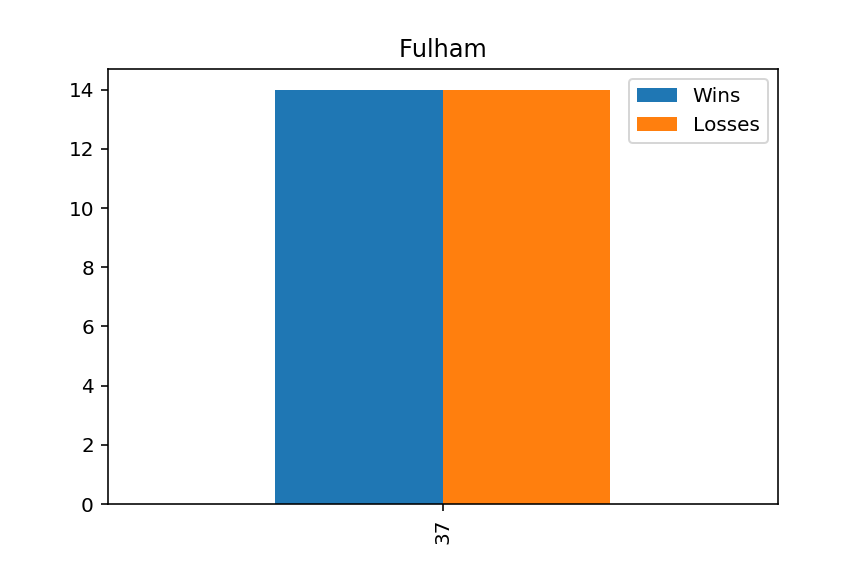

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


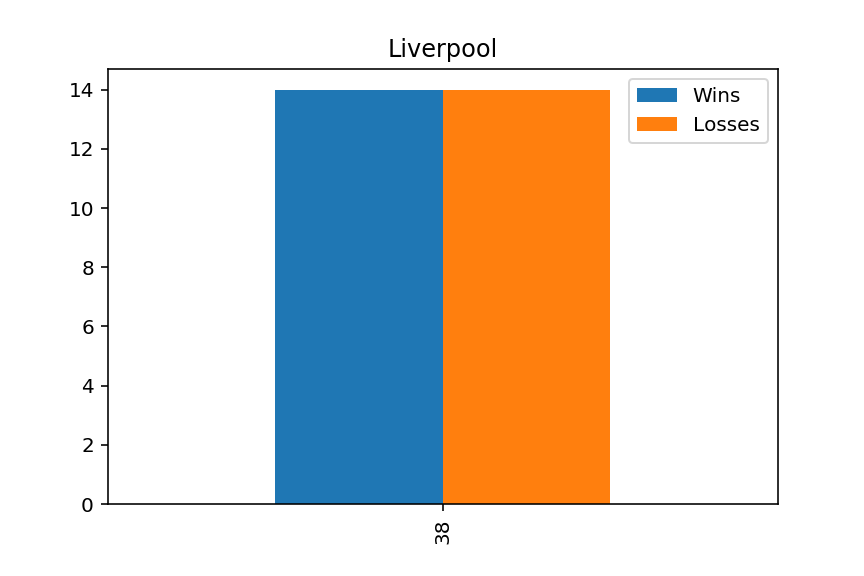

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


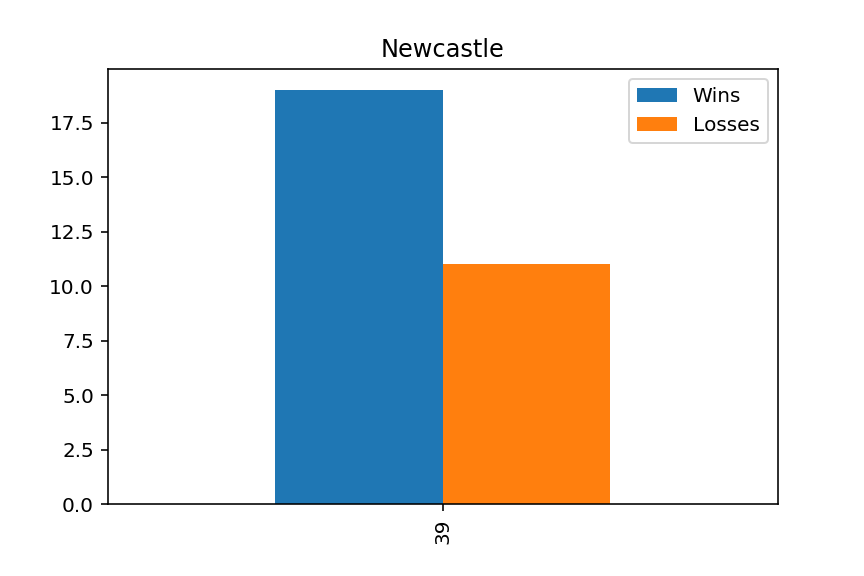

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


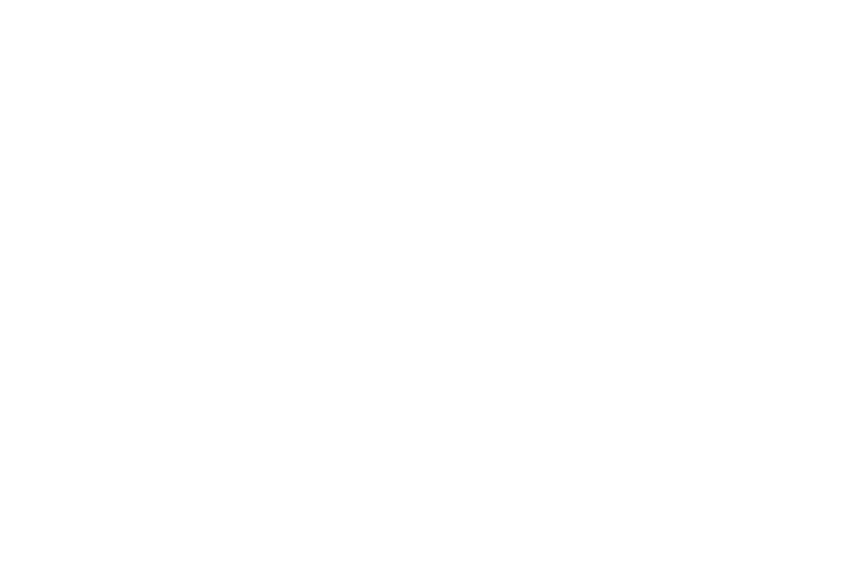

b'\x80\x04\x95\x08\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


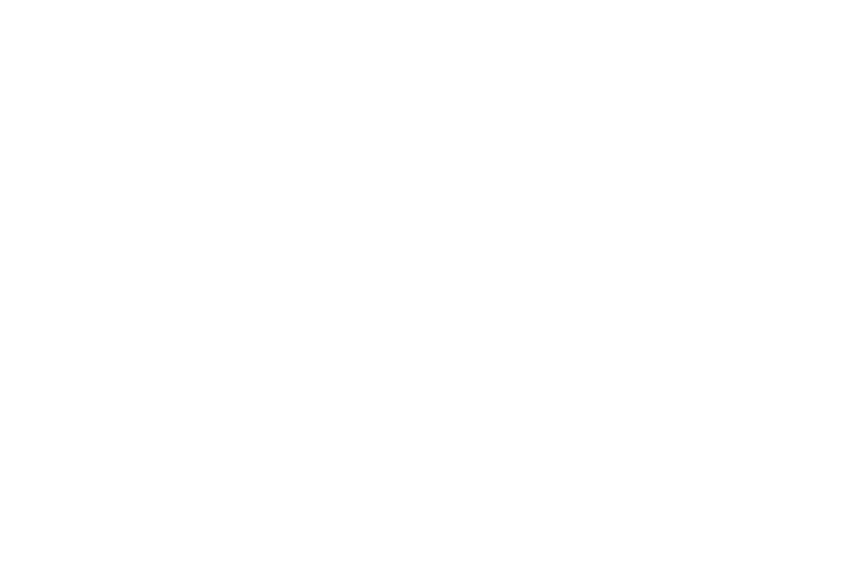

b'\x80\x04\x95\x04\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


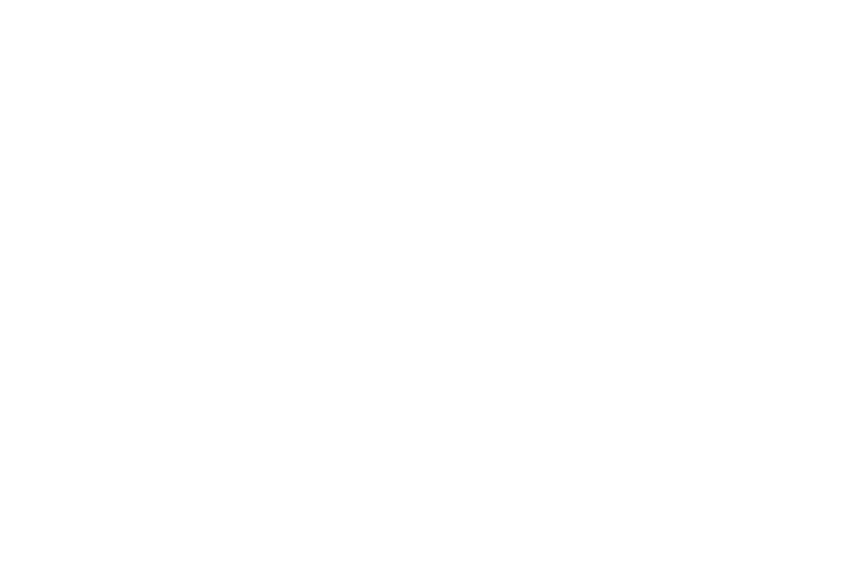

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


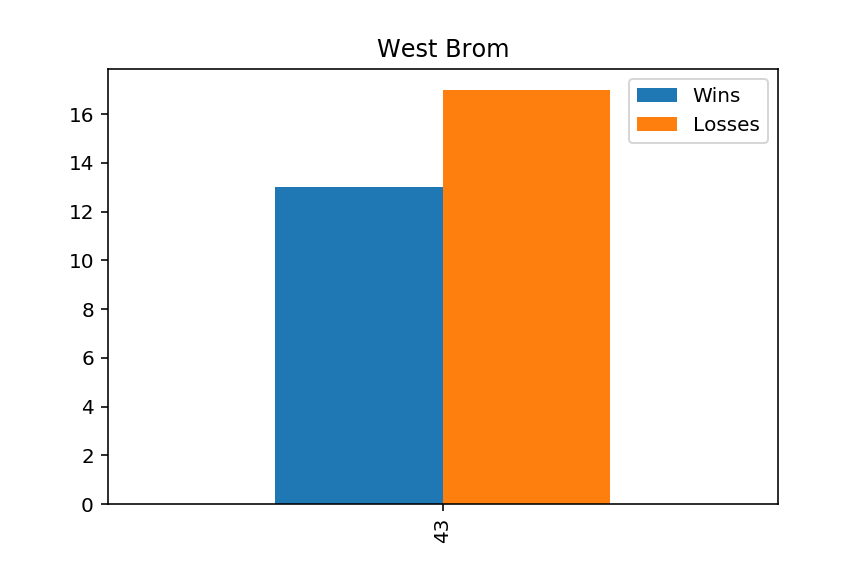

b'\x80\x04\x95\x04\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


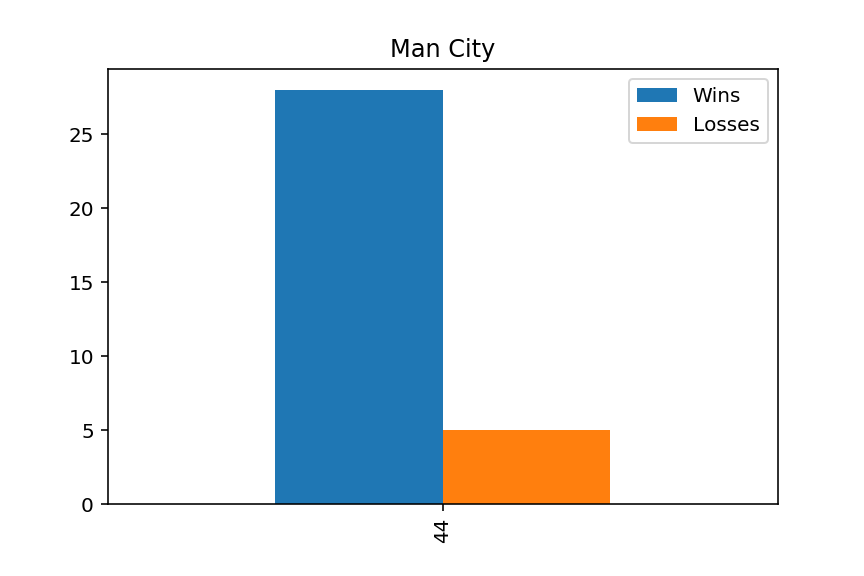

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


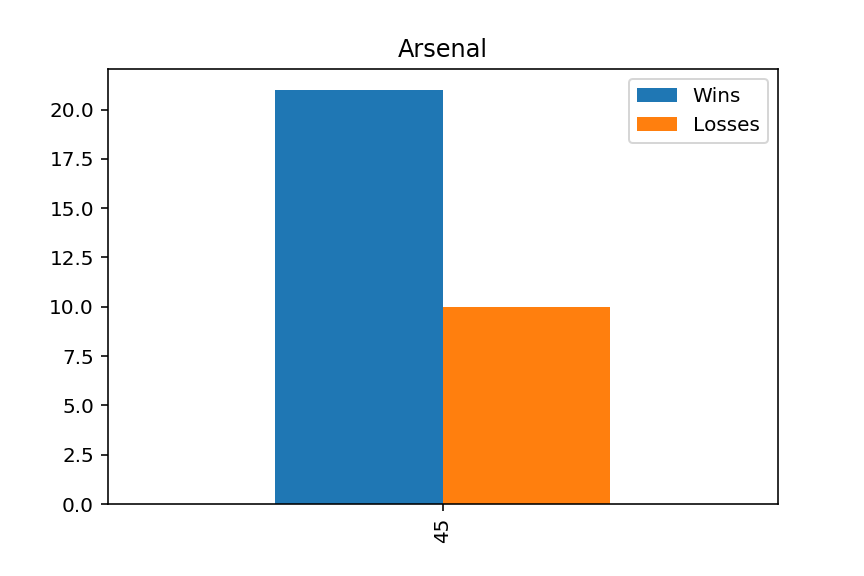

b'\x80\x04\x95\x08\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


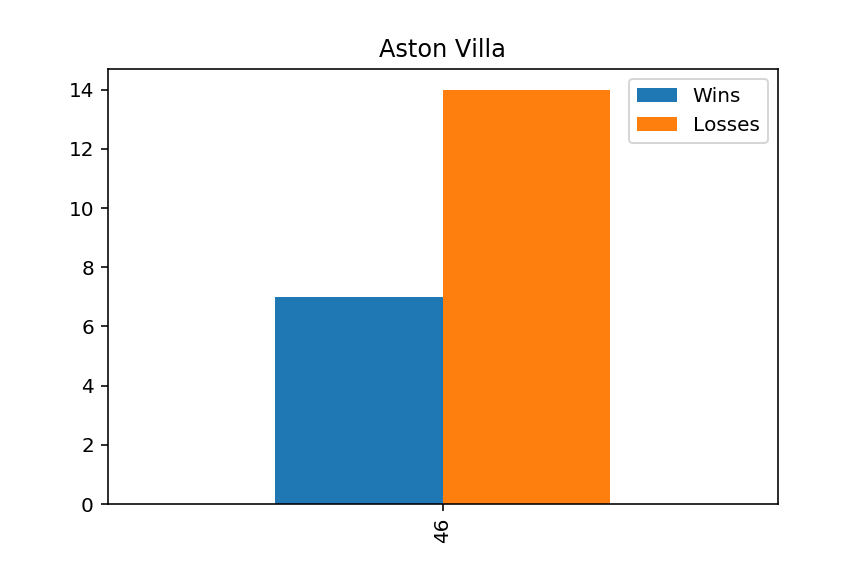

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


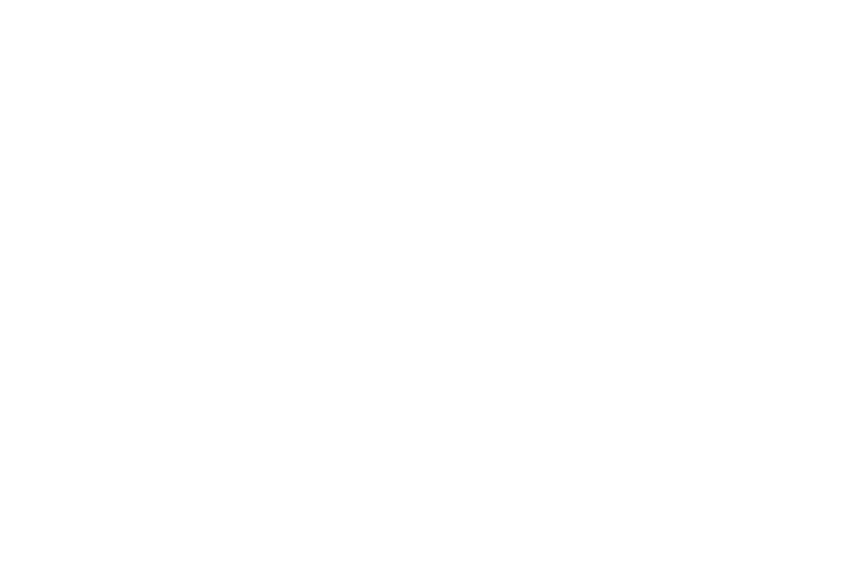

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


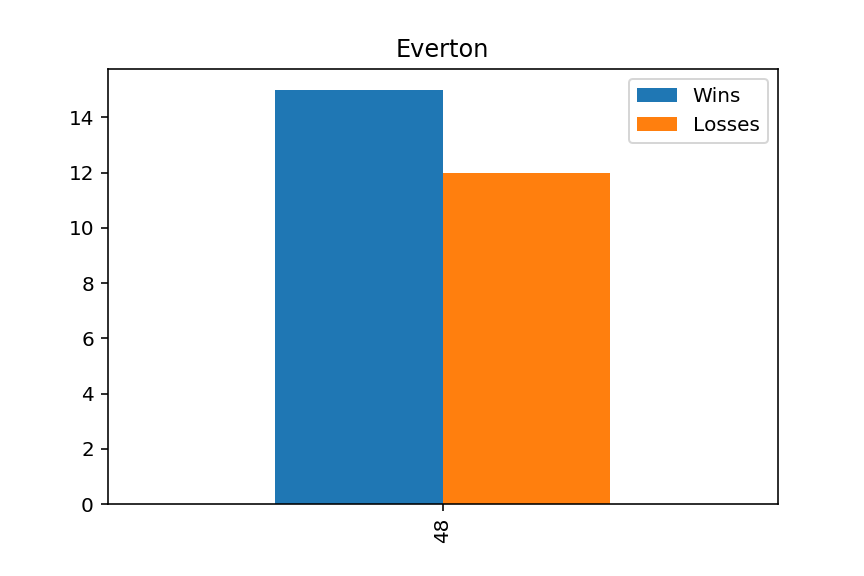

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


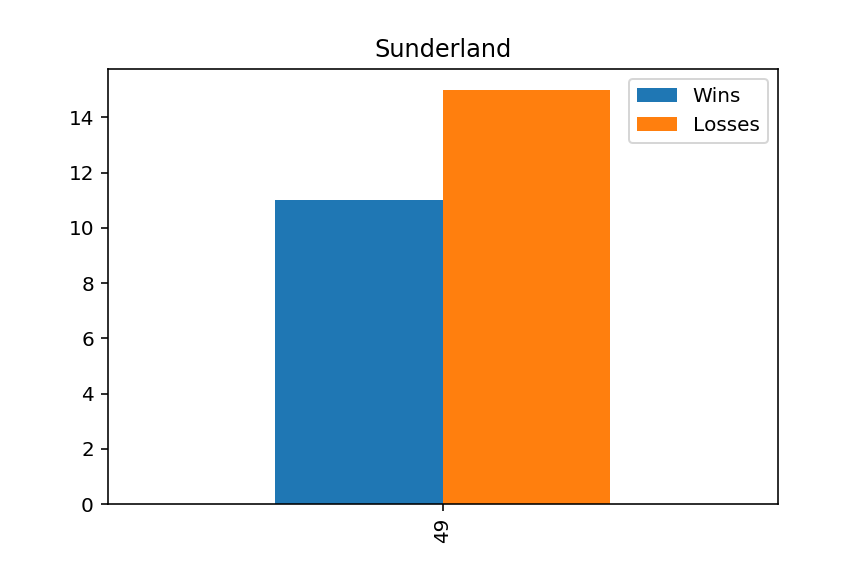

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


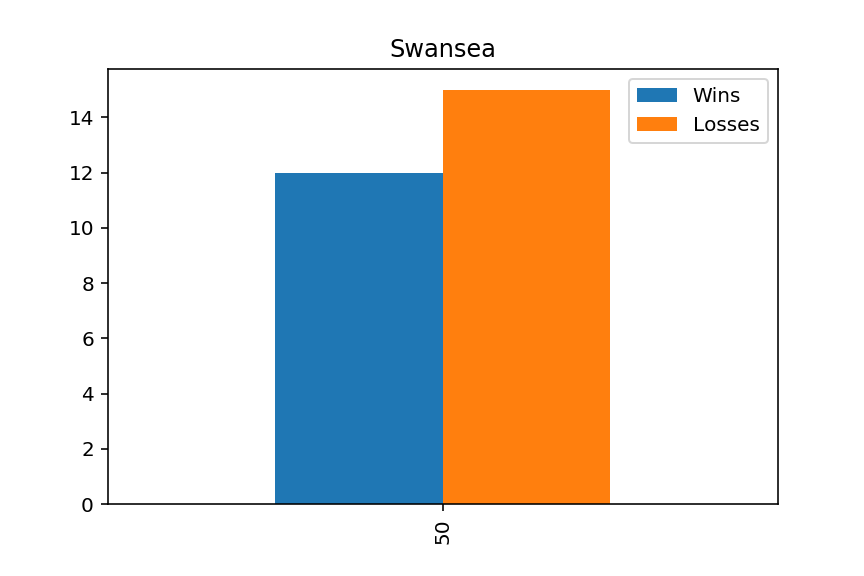

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


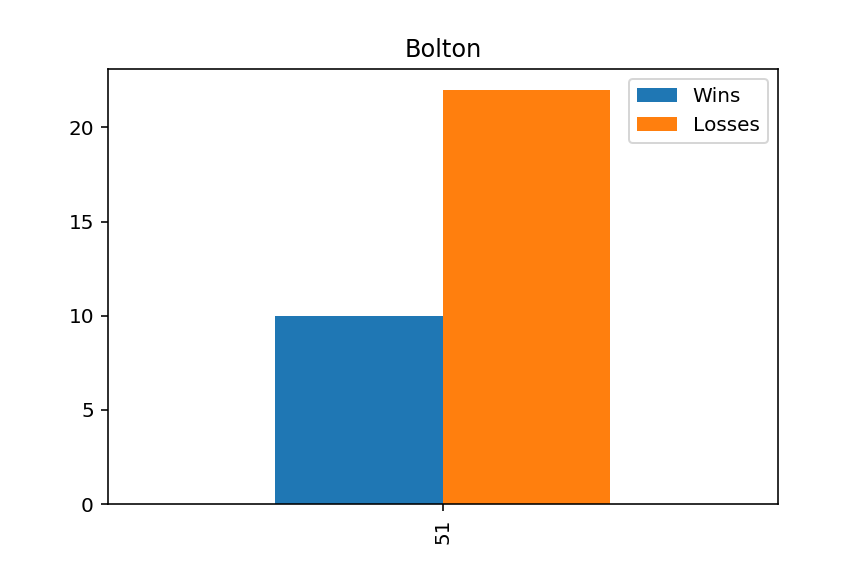

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


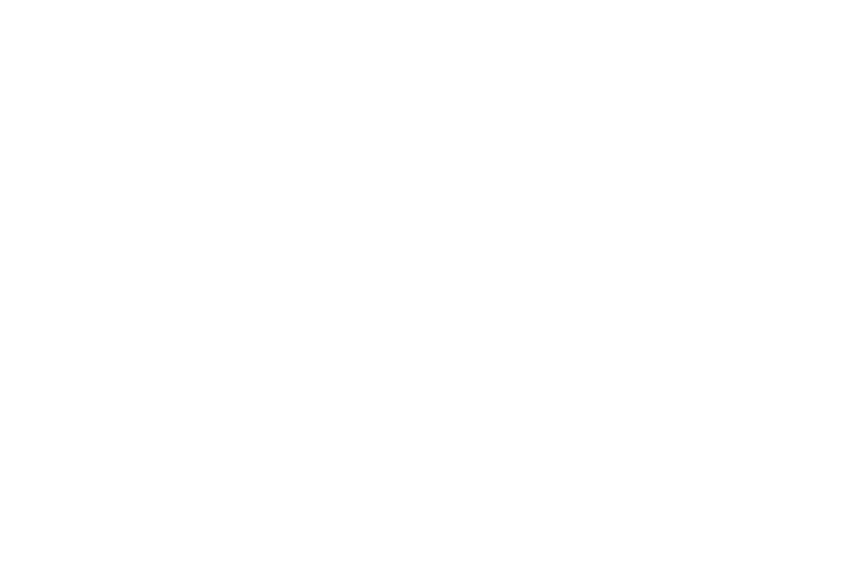

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


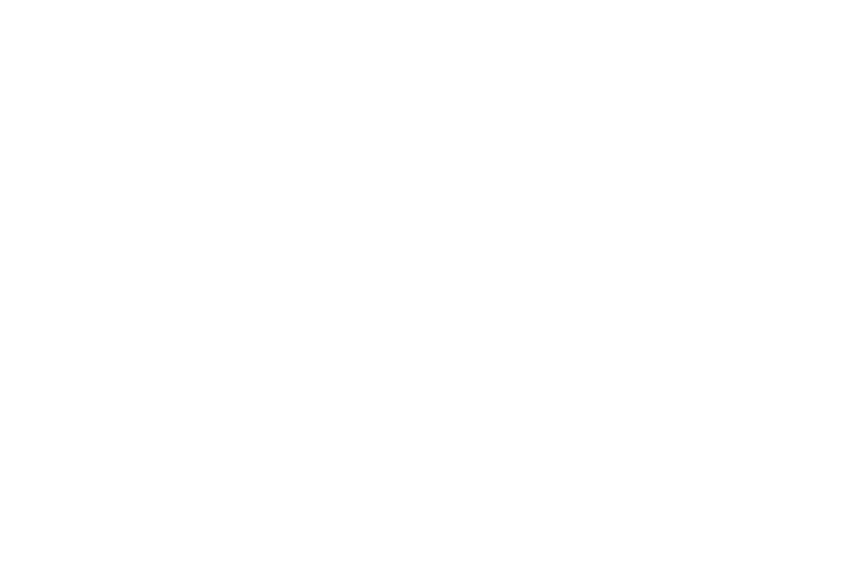

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


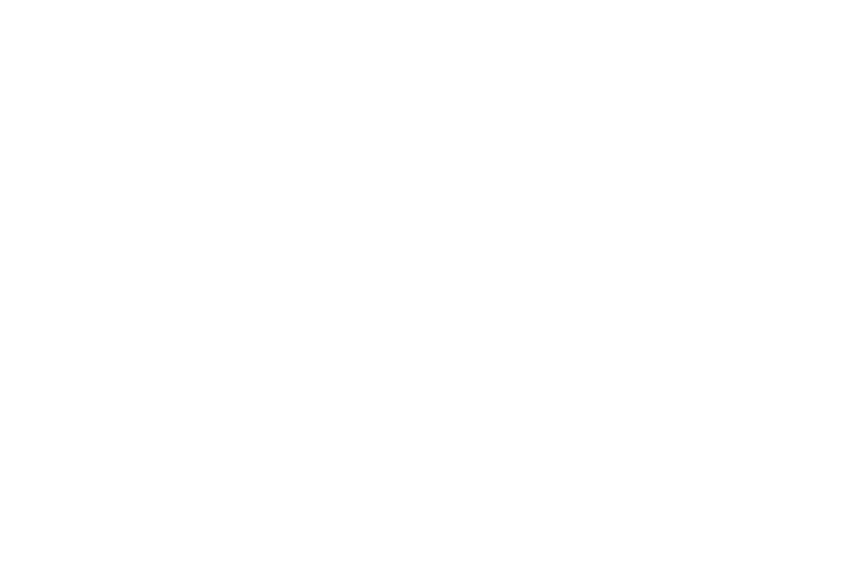

b'\x80\x04\x95\x00\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

<IPython.core.display.Javascript object>


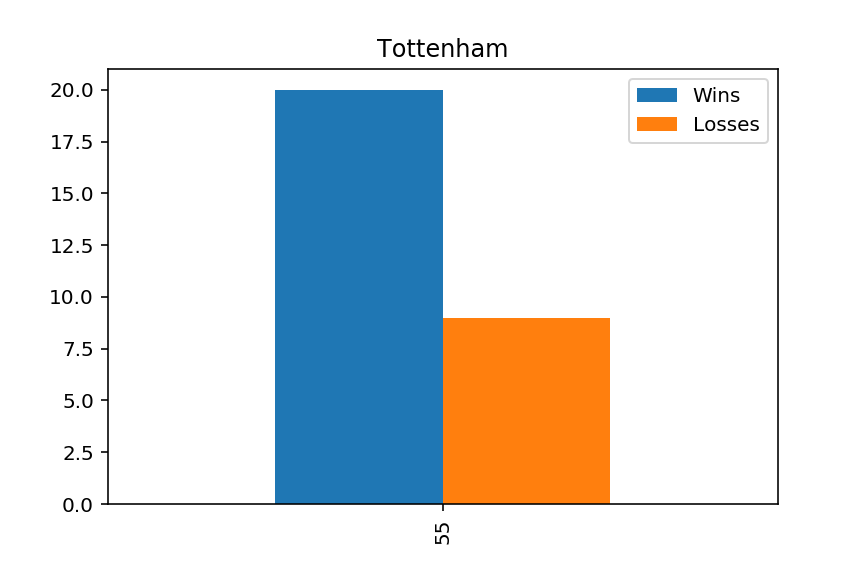

b'\x80\x04\x95\x08\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x94\x93\x94]\x94]\x94\x86\x94\x81\x94\x8c\n_in_layout\x94

In [189]:
graph_names = []
charts = []
sleep_min = 0
sleep_max = 5

for team in df2['Team'].unique():
    
    ## Graphing wins/losses and adding file names to the dataFrame
    graph = df2[['Wins', 'Losses']][df2['Team']==team].plot.bar(title = "{}".format(team));
    graph_name = '{}.pickle'.format(team)
    graph_names.append(graph_name)
    
    ## Saving graphs as jpg files
    jpg_format = '{}.jpg'.format(graph_name)
    plt.savefig(jpg_format)
    
    ## Saving graphs as pickle files
    with open(graph_name, 'wb') as f:
        graphs = pickle.dumps(graph, pickle.HIGHEST_PROTOCOL)
    charts.append(graphs)
    time.sleep(random.uniform(sleep_min, sleep_max))
    
## Adding graph names to the dataFrame   
df2['Graph Name'] = graph_names
df2['Charts'] = charts

In [173]:
df2.head()

Unnamed: 0       Team  Goals  Wins  Losses  Draws  Total Games  \
0  0           Nurnberg   38     12    16      6      17            
1  1           Stuttgart  63     15    11      8      17            
2  2           Wolfsburg  47     13    16      5      17            
3  3           Mainz      47     9     13      12     17            
4  4           Freiburg   45     10    14      10     17            

   Wins in Rain Rain Win Percentage        Graph Name  \
0  0.29          29.41%              Nurnberg.pickle    
1  0.18          17.65%              Stuttgart.pickle   
2  0.24          23.53%              Wolfsburg.pickle   
3  0.12          11.76%              Mainz.pickle       
4  0.18          17.65%              Freiburg.pickle    

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                             

# Saving DataFrames as `.CSV` and  `.JSON` files

### `Saving original DataFrame (df) as .CSV`

In [137]:
df.to_csv('/Users/jacobtadesse/Documents/LearnCo/mod2/s16/dsc-mod-2-lab-online-ds-pt-081219/df.csv')

### `Saving new DataFrame (df2) as .CSV`

In [190]:
df2.to_csv('/Users/jacobtadesse/Documents/LearnCo/mod2/s16/dsc-mod-2-lab-online-ds-pt-081219/df2.csv')

### `Saving new DataFrame (df2) as .JSON`

In [139]:
df2.to_json('/Users/jacobtadesse/Documents/LearnCo/mod2/s16/dsc-mod-2-lab-online-ds-pt-081219/df2.json')

In [140]:
df2 = pd.read_csv('df2.csv')

# CONNECT to `MONGO DB` and UPLOAD  `DataFrame` with `Custom Class` = `MongoHandler()` 

### Connecting to `Mongo_DB`

In [141]:
myclient = pymongo.MongoClient("mongodb://127.0.0.1:27017/")
mydb = myclient['2011_team_stats']
mycollection = mydb['2011_team_stats']

In [209]:
class MongoHandler(object):
    """Uploads data from DataFrame to Mongo DB
    Requires a specific database name and DataFrame
    Also allows queries when dict passed as {key:1} format
    """
    def __init__(self, data = pd.DataFrame(), q = {}):
        """ Initializing database name, data, and query parameters"""
        self.data = data
        self.q = q
        
    def db_names(self):
        """Method to check database names"""
        print(myclient.list_database_names())
        
    def collection_names(self):
        """Method to check collection names"""
        print(mydb.list_collection_names())
    
    def insert(self):
        """Method to insert dataFrame"""
        results_2 = mycollection.insert_many(self.data.to_dict('records'))
        return len(results_2.inserted_ids)
        
    def query(self):
        """Methos to return query results"""
        query = mycollection.find({}, self.q)
        for x in query:
            print(x) 
            
    def total(self):
        """Methos to ceck total records in Database"""
        query = mycollection.find({})
        tot = []
        for x in query:
            tot.append(x)
        return len(tot)
        
    def delete_all(self):
        """Method to delete all records in Database"""
        delete_all = mycollection.delete_many({})
        return delete_all.deleted_count        
        

### Instantiating `MongoHandler()`

In [191]:
upload = MongoHandler(data = df2)

### Checking connection to MongoDB

In [192]:
upload.db_names()
upload.collection_names()

['2011_team_stats', 'admin', 'config', 'example_database', 'lab_db', 'local', 'pokemon_db', 'test']
['2011_team_stats']


### Inserting Data into MongoDB using built-in method

In [193]:
upload.insert()
upload.total() # checking total

112

### Deleting all data from MongoDB using built-in method

In [194]:
upload.delete_all()
upload.insert() # checking the number inserted

56

### Querying the MongoDB using built-in method

In [195]:
upload.q = {'Team':1,'Wins':1, 'Losses':1, 'Total Games':1,'Graph Name':1}

In [182]:
upload.query()

{'_id': ObjectId('5db47febca2b8c586aea01bc'), 'Team': 'Nurnberg', 'Wins': 12, 'Losses': 16, 'Total Games': 17, 'Graph Name': 'Nurnberg.pickle'}
{'_id': ObjectId('5db47febca2b8c586aea01bd'), 'Team': 'Stuttgart', 'Wins': 15, 'Losses': 11, 'Total Games': 17, 'Graph Name': 'Stuttgart.pickle'}
{'_id': ObjectId('5db47febca2b8c586aea01be'), 'Team': 'Wolfsburg', 'Wins': 13, 'Losses': 16, 'Total Games': 17, 'Graph Name': 'Wolfsburg.pickle'}
{'_id': ObjectId('5db47febca2b8c586aea01bf'), 'Team': 'Mainz', 'Wins': 9, 'Losses': 13, 'Total Games': 17, 'Graph Name': 'Mainz.pickle'}
{'_id': ObjectId('5db47febca2b8c586aea01c0'), 'Team': 'Freiburg', 'Wins': 10, 'Losses': 14, 'Total Games': 17, 'Graph Name': 'Freiburg.pickle'}
{'_id': ObjectId('5db47febca2b8c586aea01c1'), 'Team': "M'gladbach", 'Wins': 17, 'Losses': 8, 'Total Games': 17, 'Graph Name': "M'gladbach.pickle"}
{'_id': ObjectId('5db47febca2b8c586aea01c2'), 'Team': 'Hamburg', 'Wins': 8, 'Losses': 14, 'Total Games': 17, 'Graph Name': 'Hamburg.pick

### Standard query with .find() method // Loading Pickle Images

In [207]:
query_test = mycollection.find({'Team': 'Bochum'},{'Charts':1})
for x in query_test:
    print(x)

{'_id': ObjectId('5db482b3ca2b8c586aea023f'), 'Charts': b'\x80\x04\x95\x04\x00\x01\x00\x00\x00\x00\x00\x8c\x19matplotlib.axes._subplots\x94\x8c$_picklable_subplot_class_constructor\x94\x93\x94\x8c\x15matplotlib.axes._axes\x94\x8c\x04Axes\x94\x93\x94\x85\x94R\x94}\x94(\x8c\x06figure\x94\x8c\x11matplotlib.figure\x94\x8c\x06Figure\x94\x93\x94)\x81\x94}\x94(\x8c\x06_stale\x94\x88\x8c\x0estale_callback\x94Nh\tN\x8c\n_transform\x94N\x8c\r_transformSet\x94\x89\x8c\x08_visible\x94\x88\x8c\t_animated\x94\x89\x8c\x06_alpha\x94N\x8c\x07clipbox\x94N\x8c\t_clippath\x94N\x8c\x07_clipon\x94\x88\x8c\x06_label\x94\x8c\x00\x94\x8c\x07_picker\x94N\x8c\t_contains\x94N\x8c\x0b_rasterized\x94N\x8c\x0b_agg_filter\x94N\x8c\n_mouseover\x94\x89\x8c\x08eventson\x94\x89\x8c\x04_oid\x94K\x00\x8c\x0e_propobservers\x94}\x94\x8c\x0e_remove_method\x94N\x8c\x04_url\x94N\x8c\x04_gid\x94N\x8c\x05_snap\x94N\x8c\x07_sketch\x94N\x8c\r_path_effects\x94]\x94\x8c\r_sticky_edges\x94\x8c\x11matplotlib.artist\x94\x8c\x07_XYPair\x

<IPython.core.display.Javascript object>


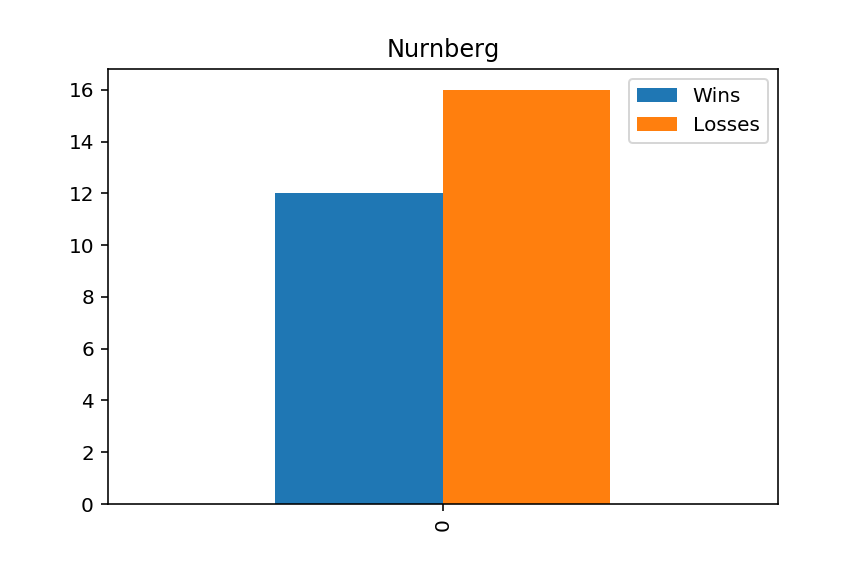

<IPython.core.display.Javascript object>


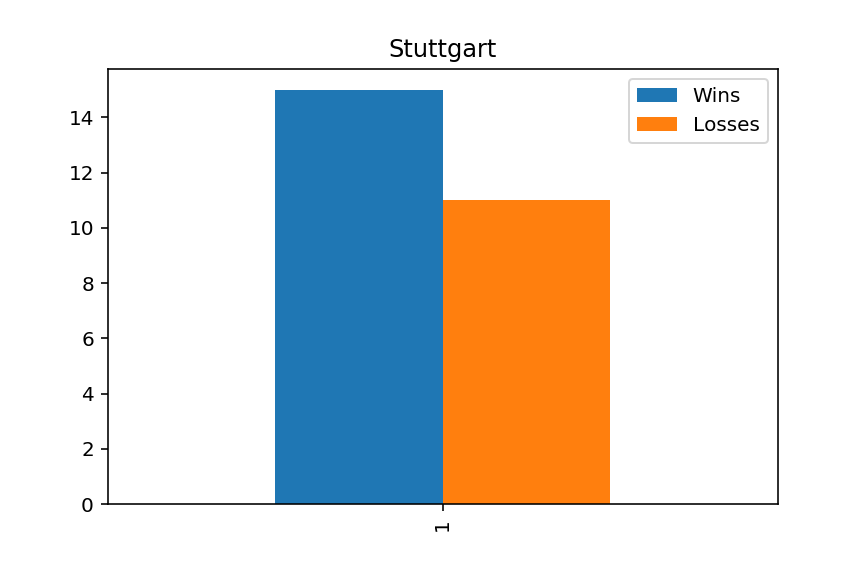

<IPython.core.display.Javascript object>


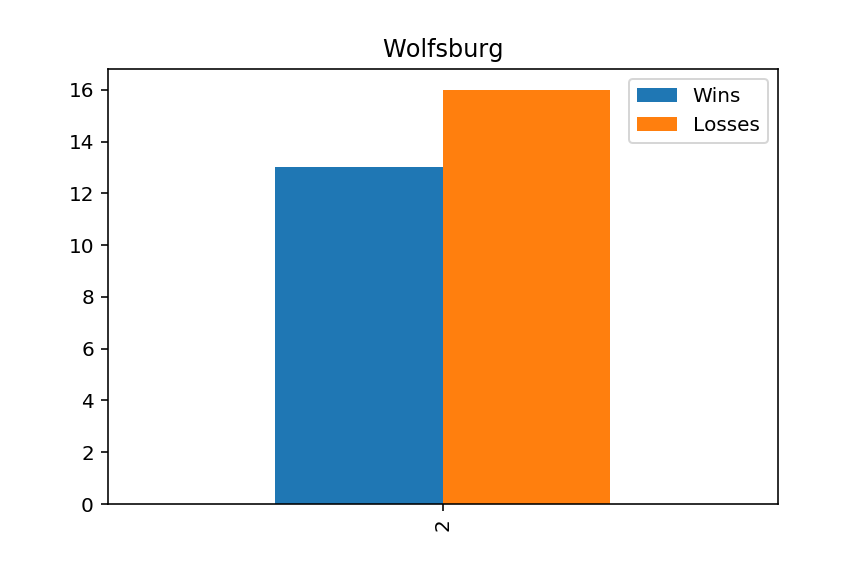

<IPython.core.display.Javascript object>


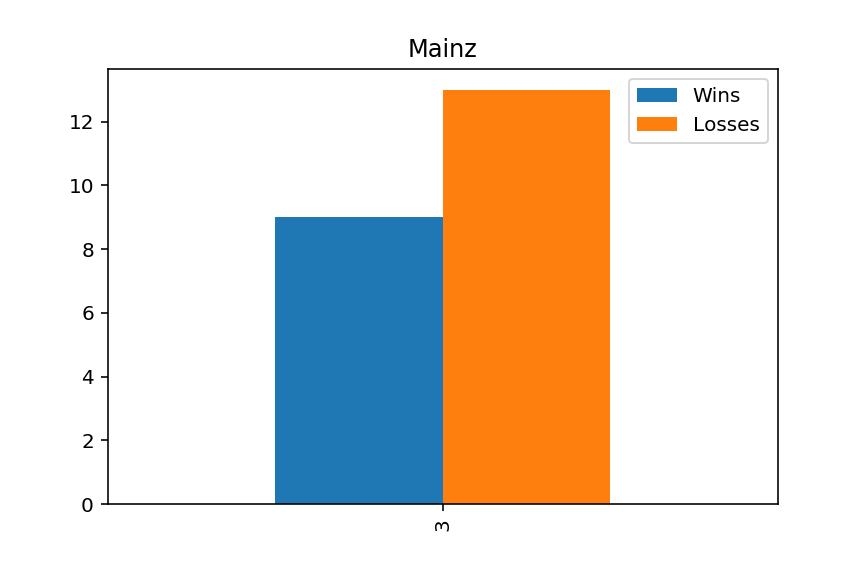

<IPython.core.display.Javascript object>


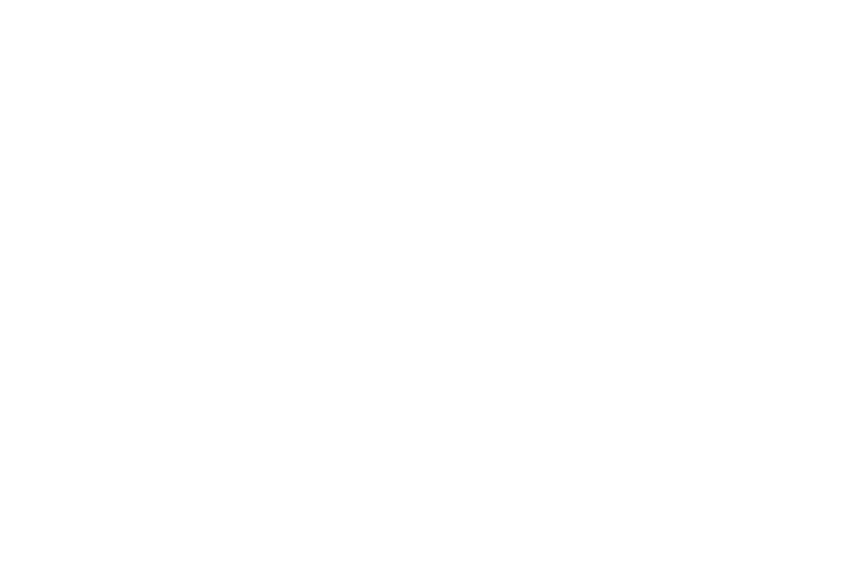

<IPython.core.display.Javascript object>


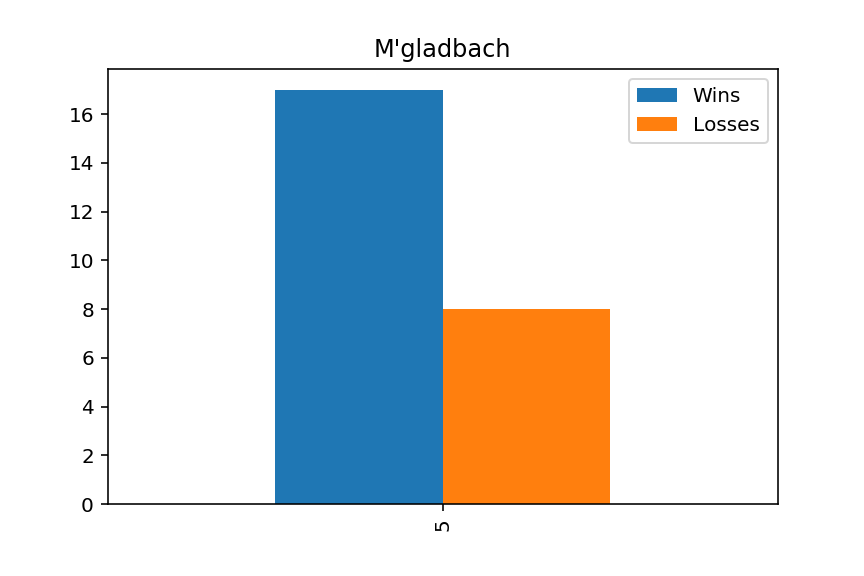

<IPython.core.display.Javascript object>


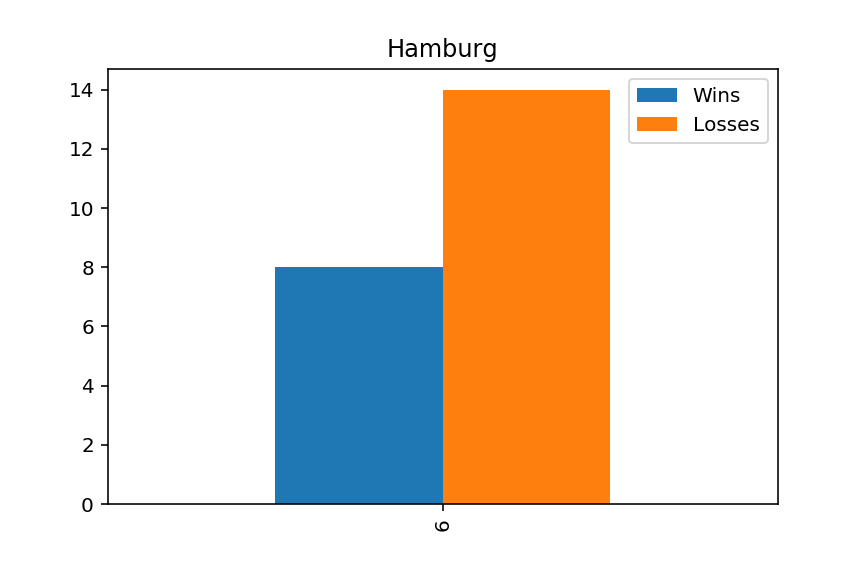

<IPython.core.display.Javascript object>


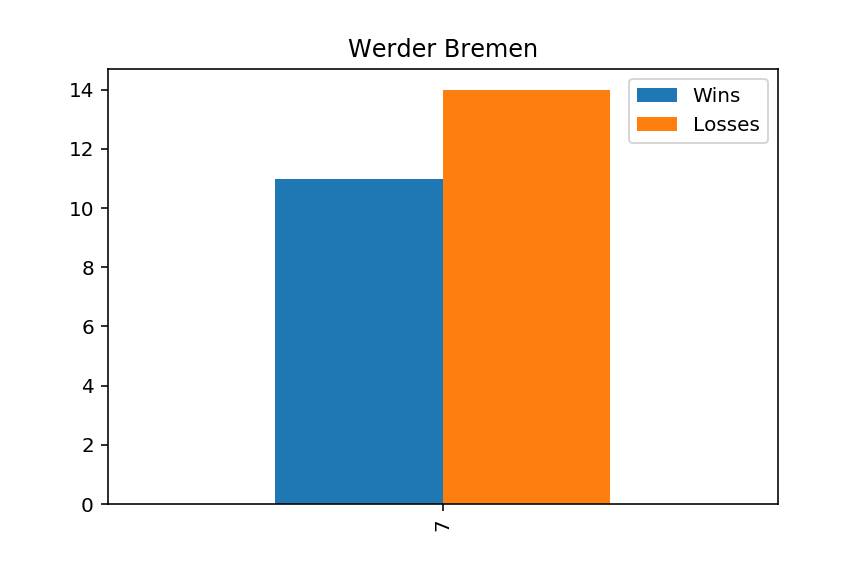

<IPython.core.display.Javascript object>


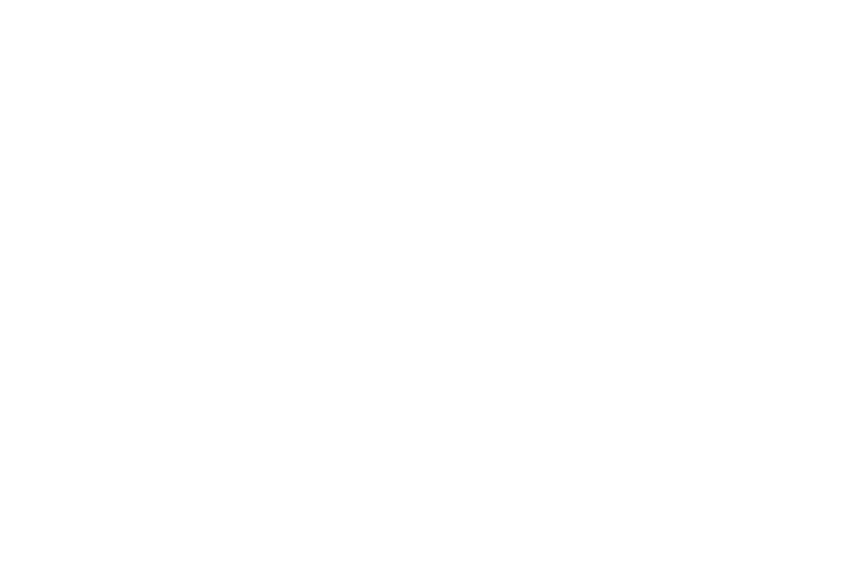

<IPython.core.display.Javascript object>


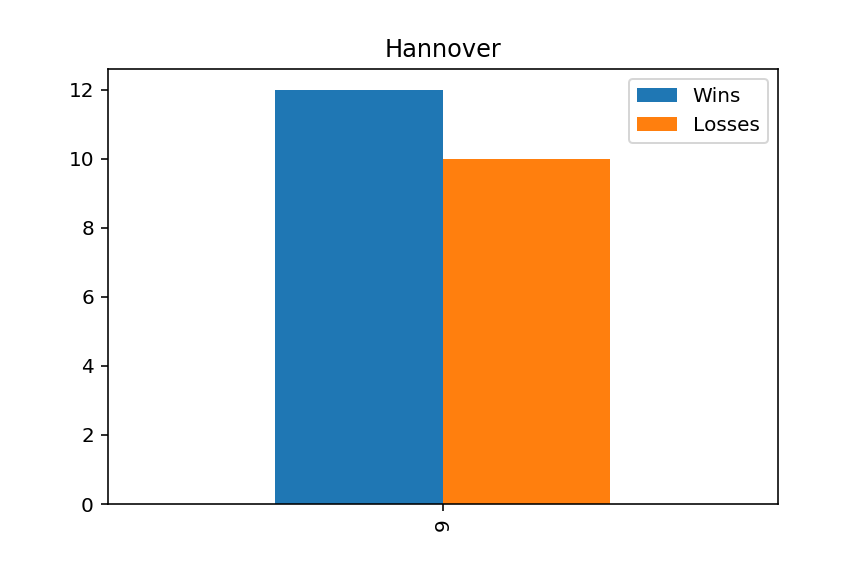

<IPython.core.display.Javascript object>


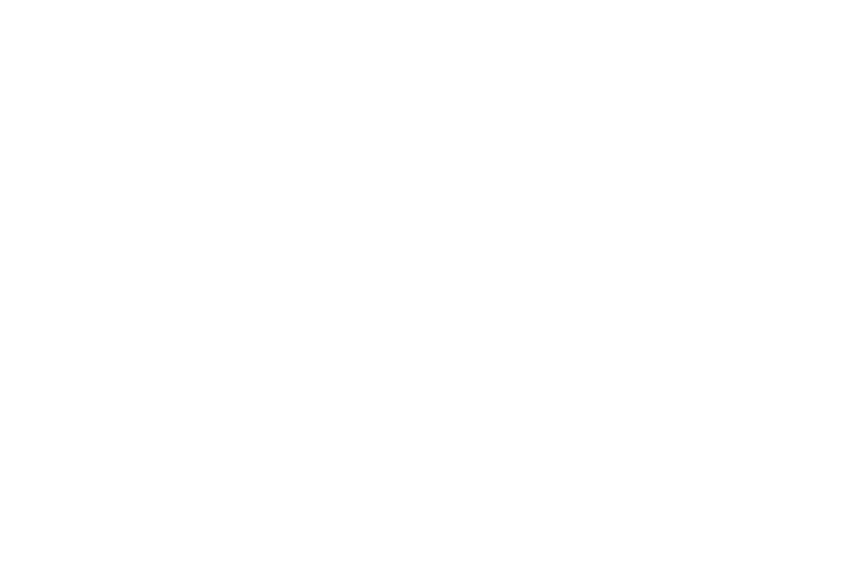

<IPython.core.display.Javascript object>


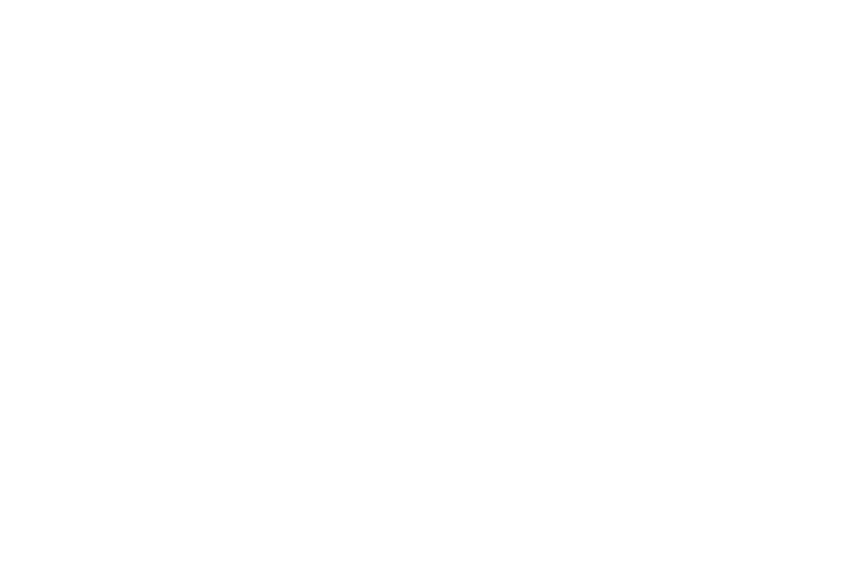

<IPython.core.display.Javascript object>


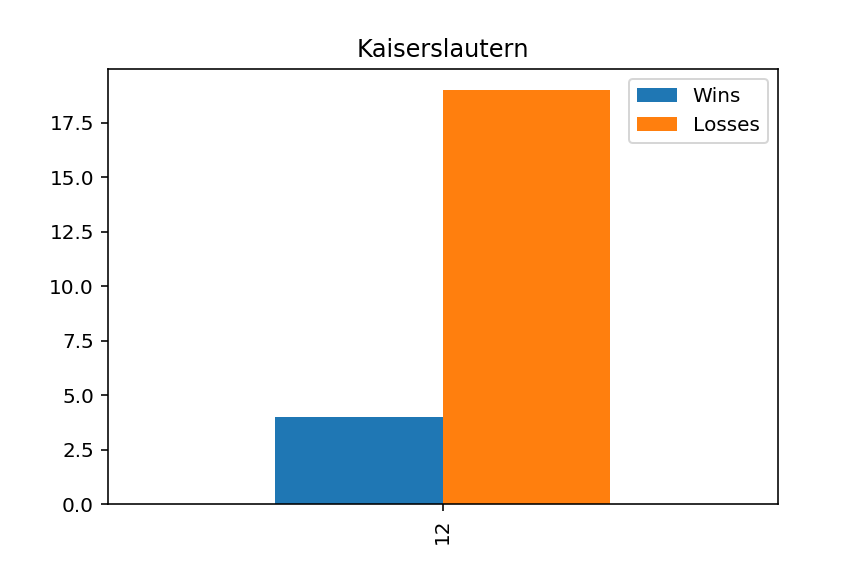

<IPython.core.display.Javascript object>


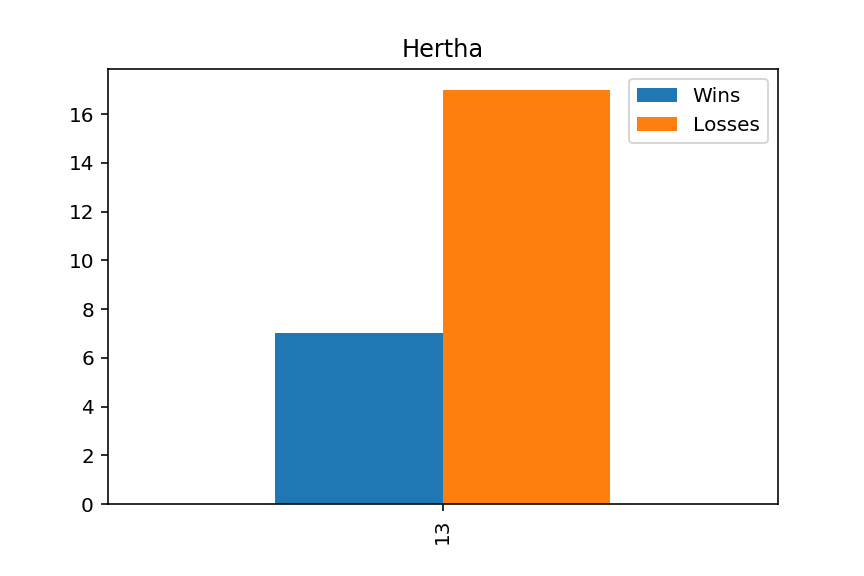

<IPython.core.display.Javascript object>


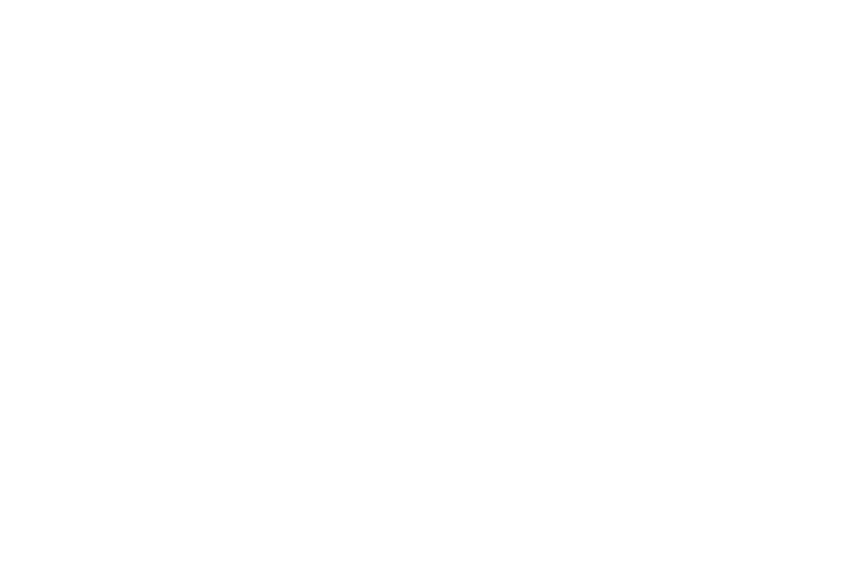

<IPython.core.display.Javascript object>


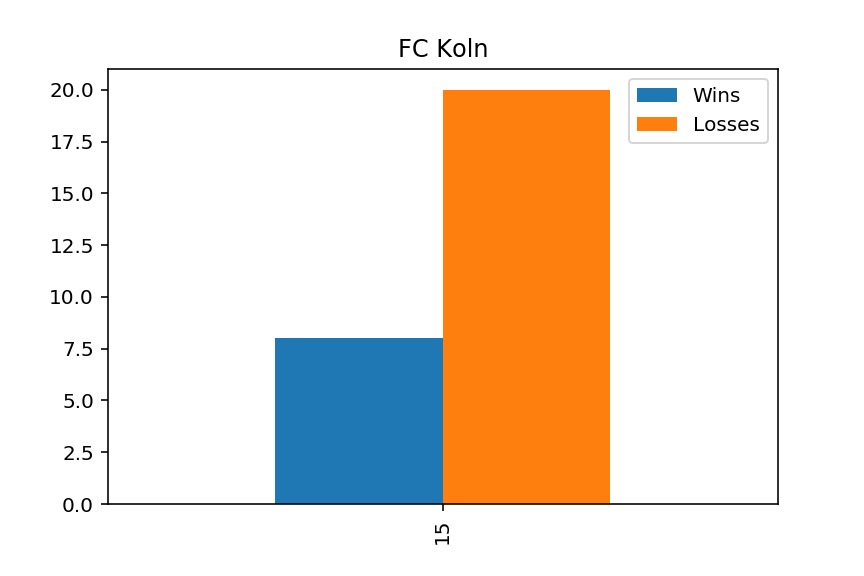

<IPython.core.display.Javascript object>


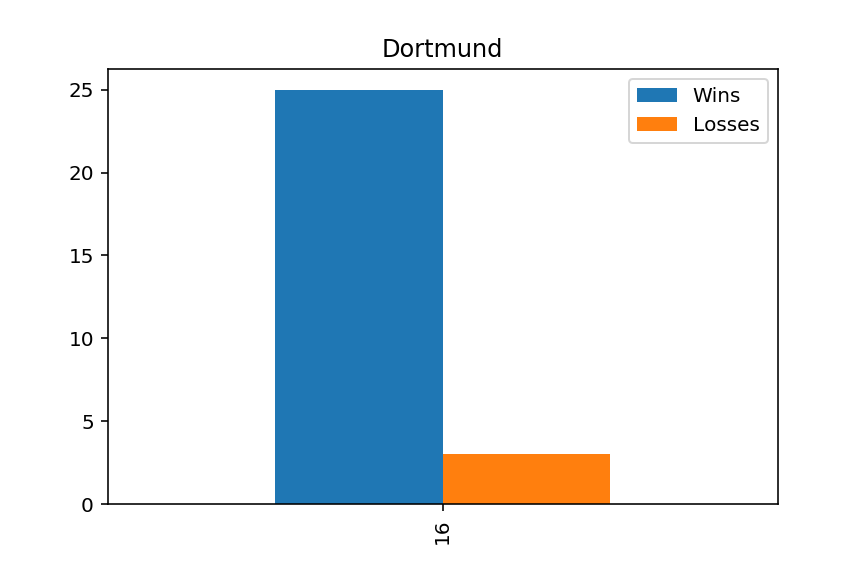

<IPython.core.display.Javascript object>


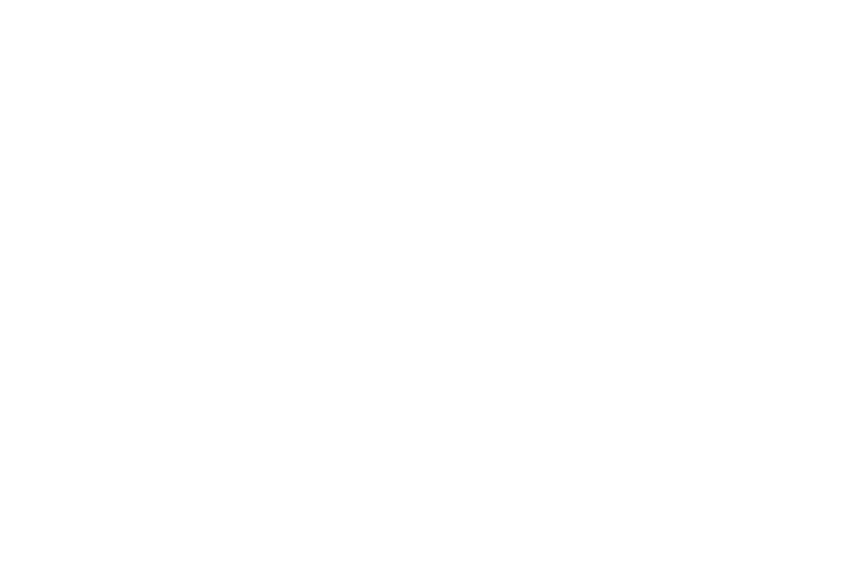

<IPython.core.display.Javascript object>


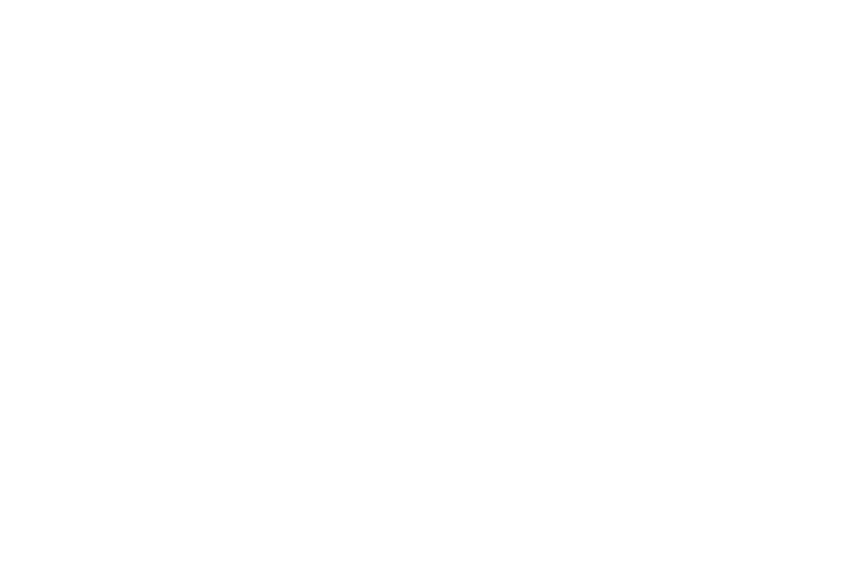

<IPython.core.display.Javascript object>


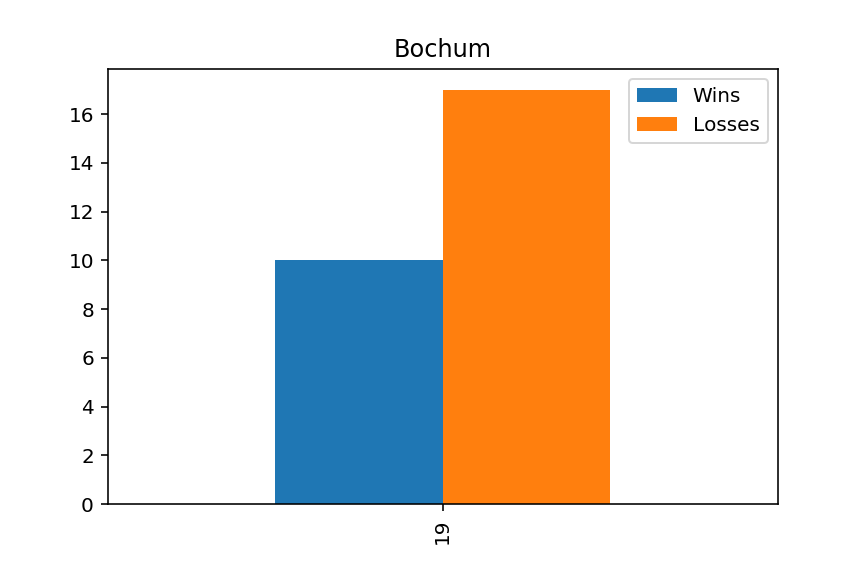

<IPython.core.display.Javascript object>


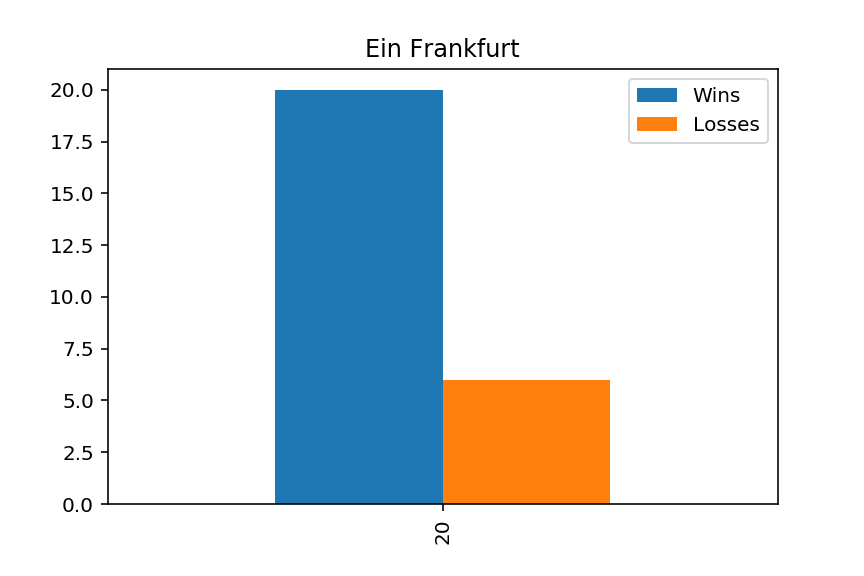

<IPython.core.display.Javascript object>


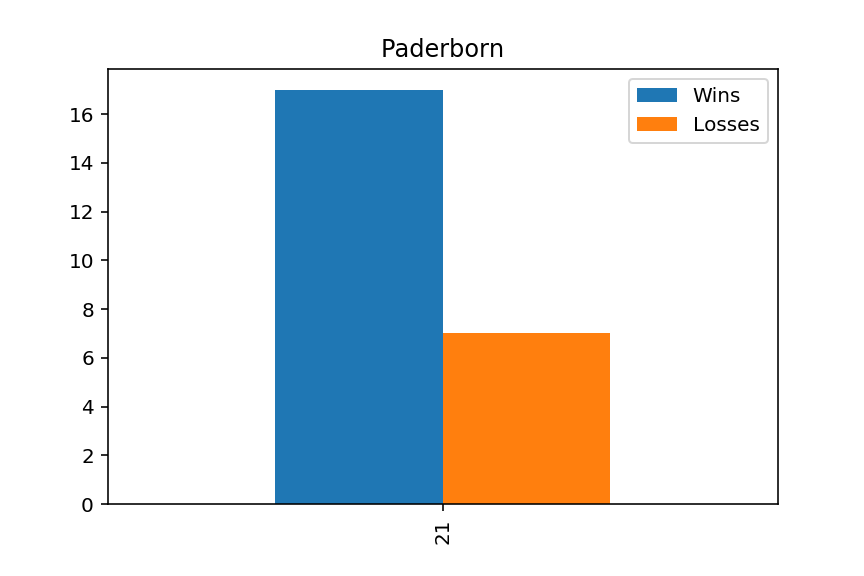

<IPython.core.display.Javascript object>


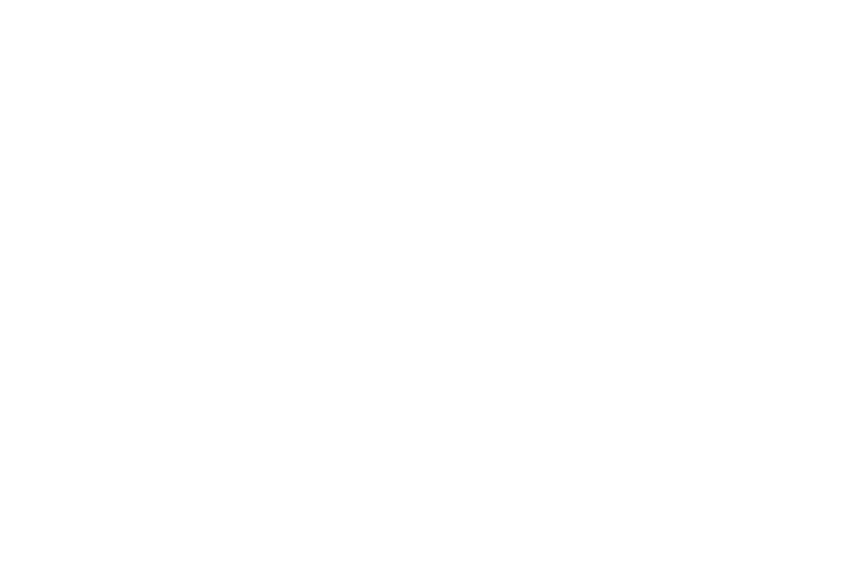

<IPython.core.display.Javascript object>


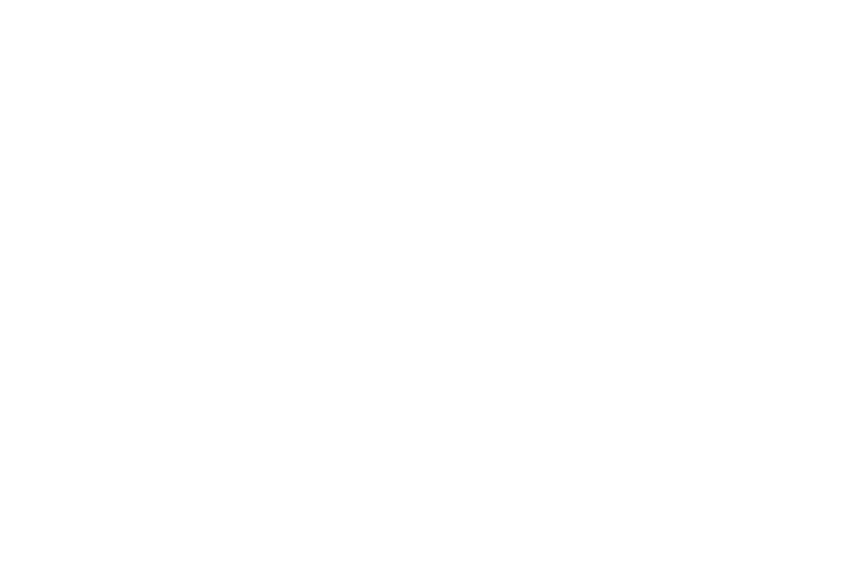

<IPython.core.display.Javascript object>


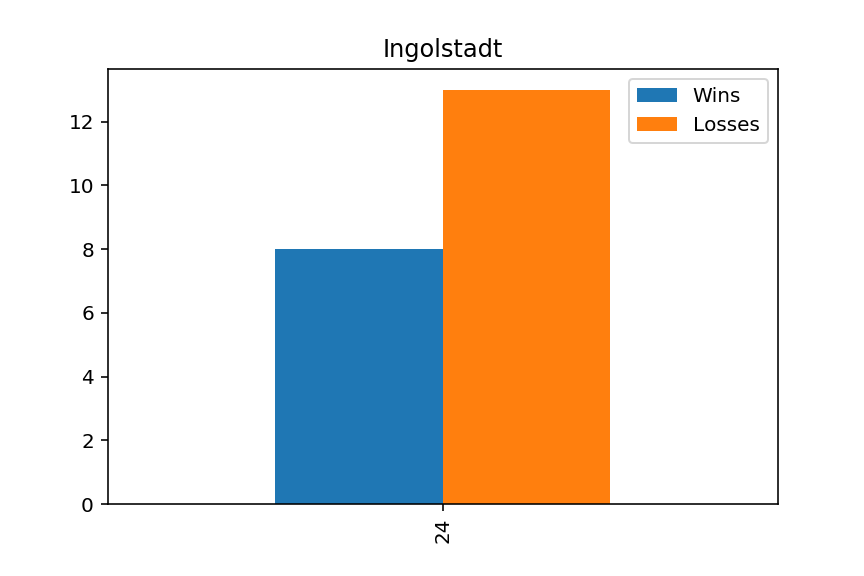

<IPython.core.display.Javascript object>


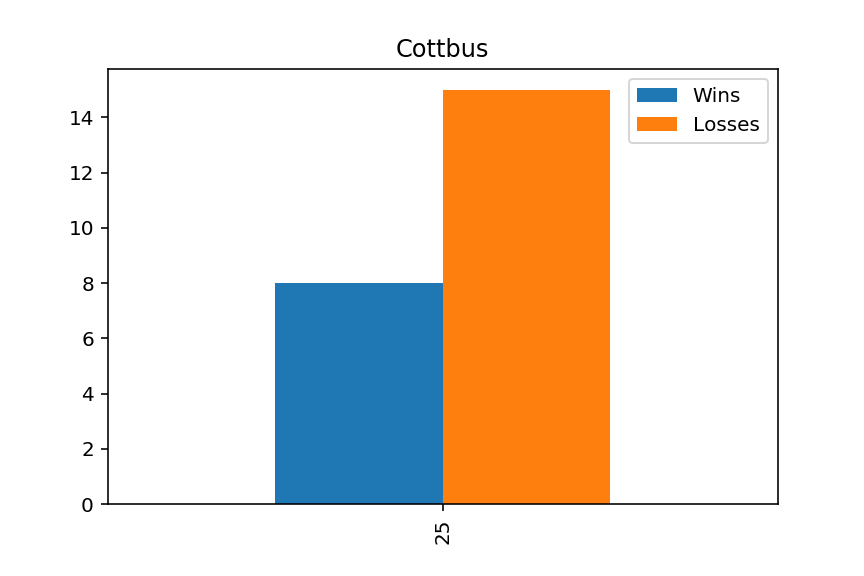

<IPython.core.display.Javascript object>


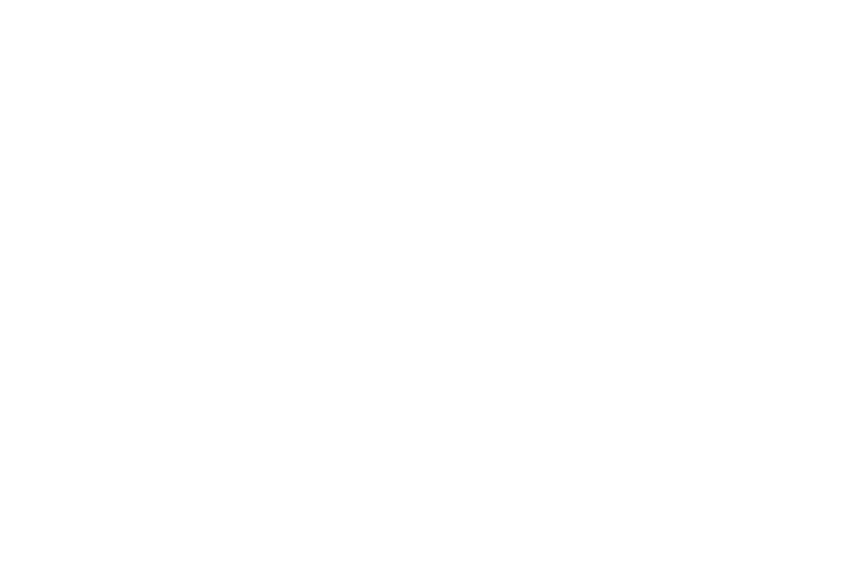

<IPython.core.display.Javascript object>


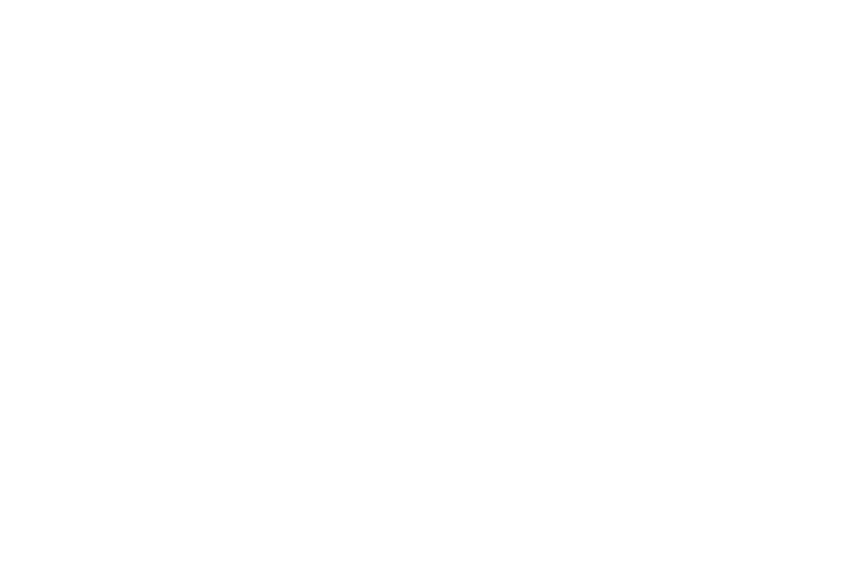

<IPython.core.display.Javascript object>


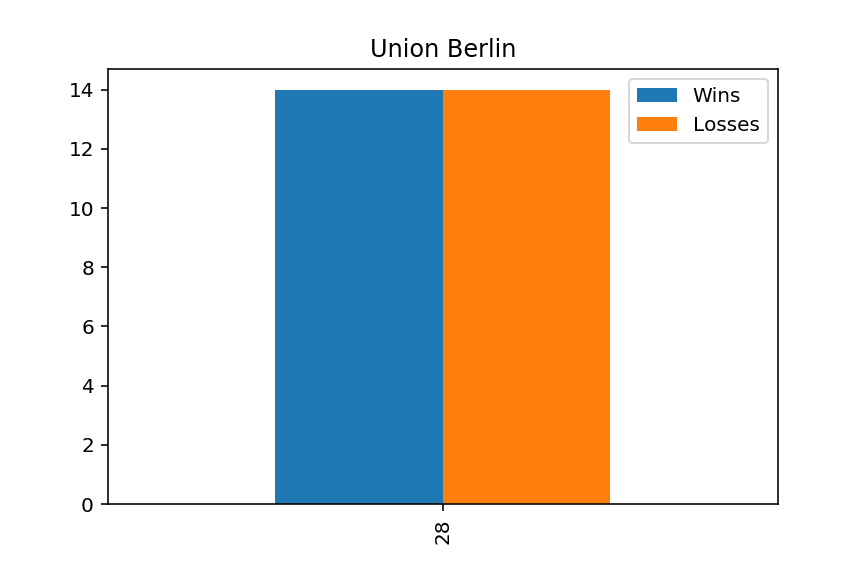

<IPython.core.display.Javascript object>


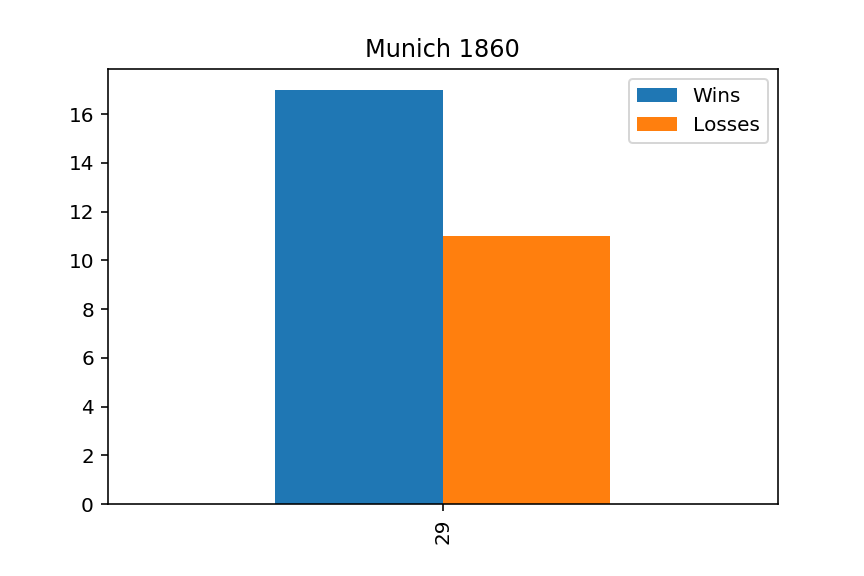

<IPython.core.display.Javascript object>


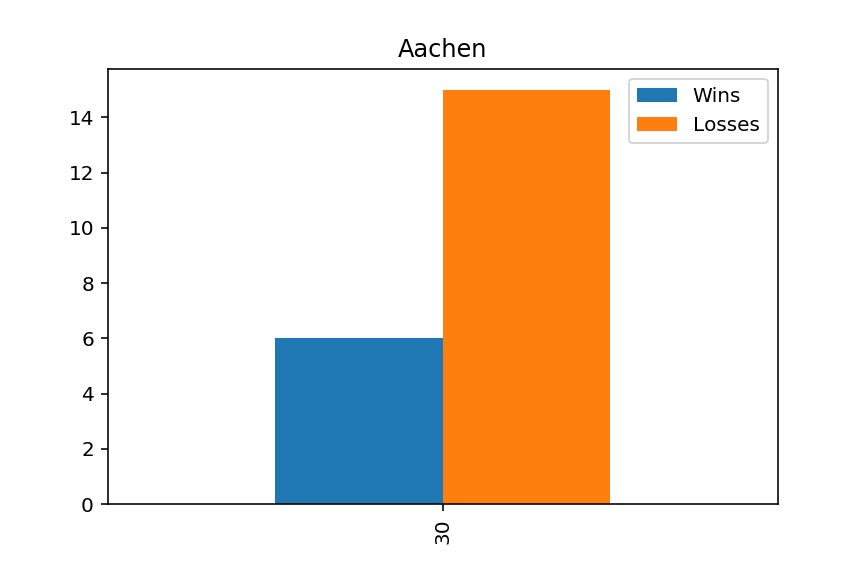

<IPython.core.display.Javascript object>


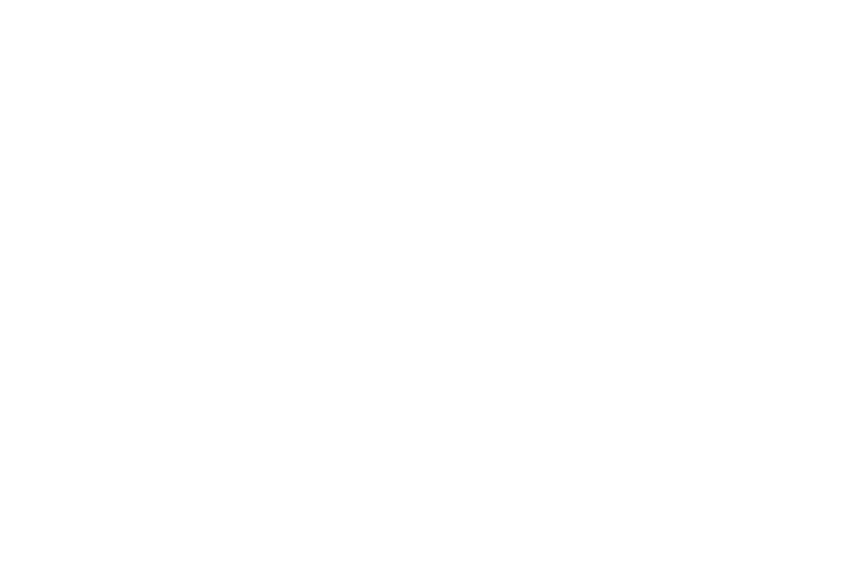

<IPython.core.display.Javascript object>


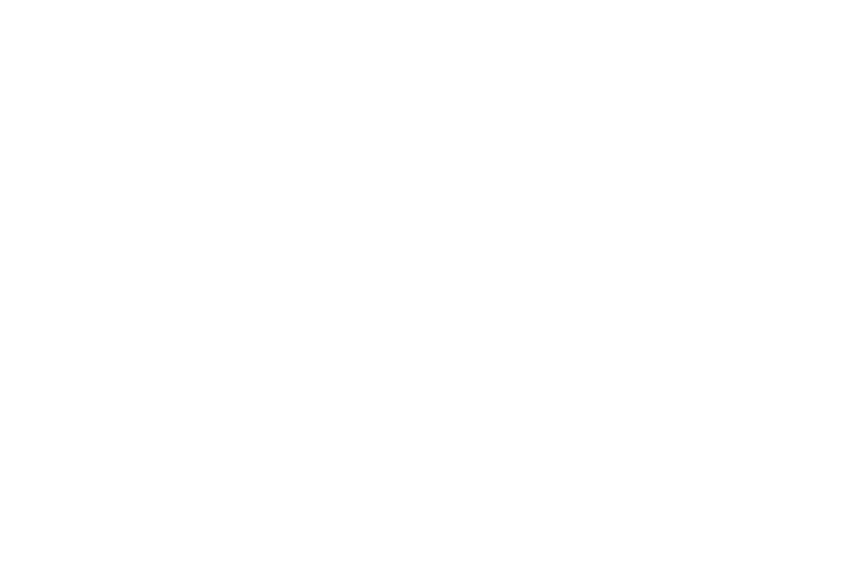

<IPython.core.display.Javascript object>


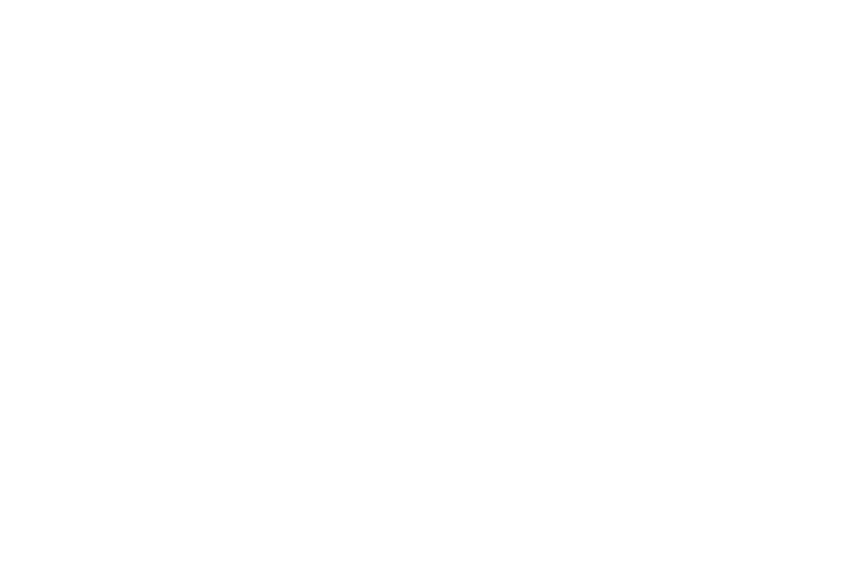

<IPython.core.display.Javascript object>


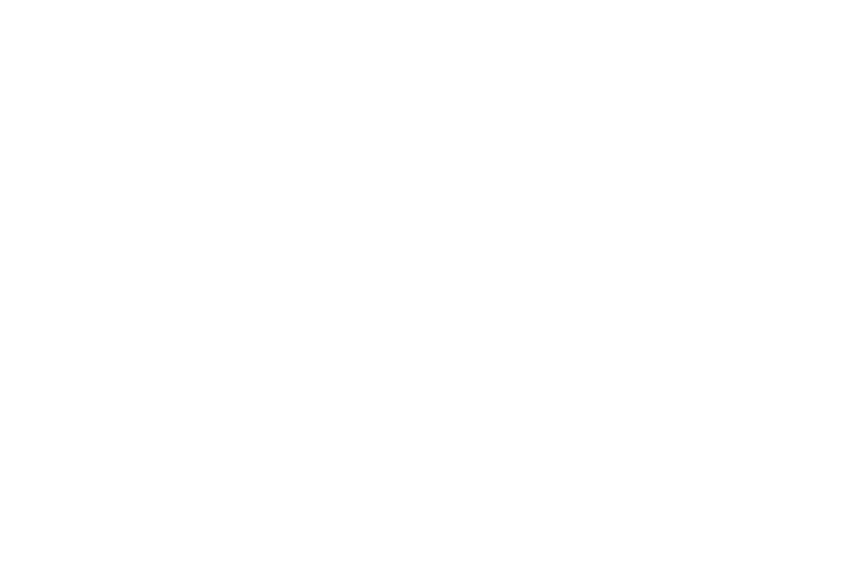

<IPython.core.display.Javascript object>


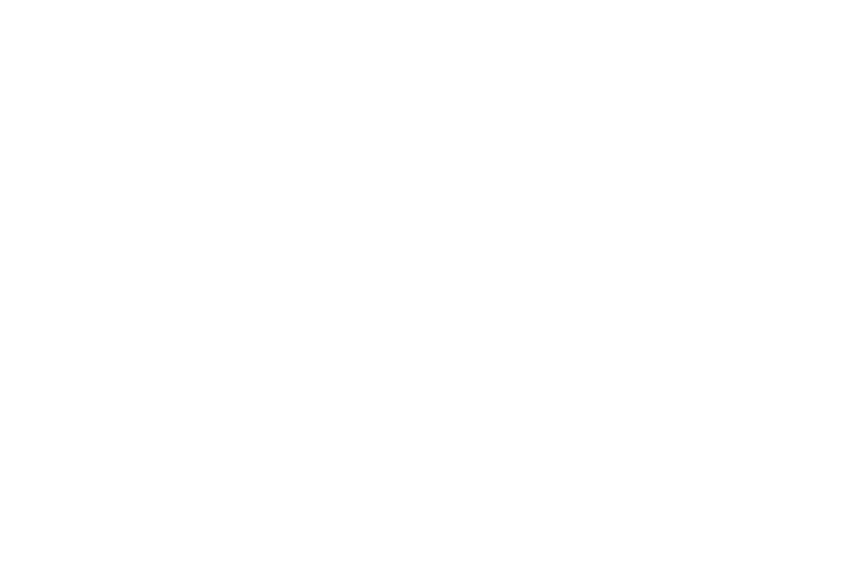

<IPython.core.display.Javascript object>


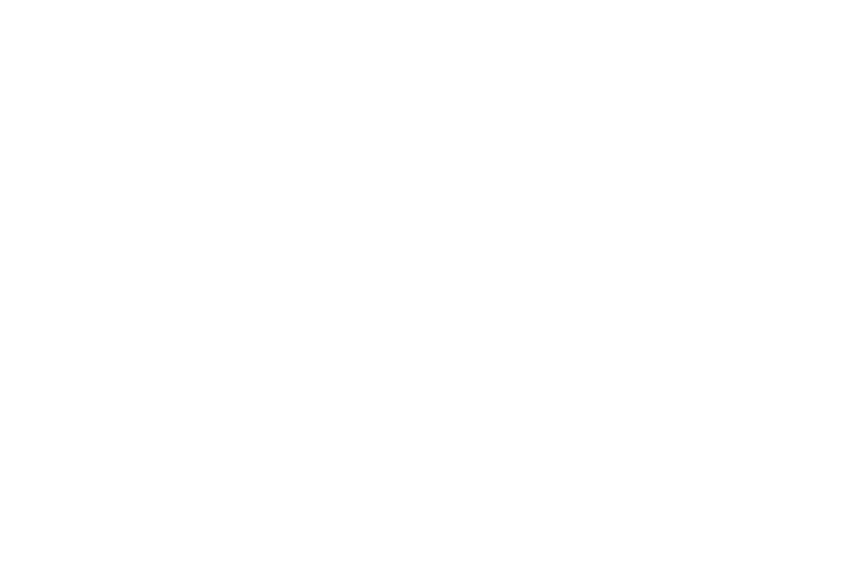

<IPython.core.display.Javascript object>


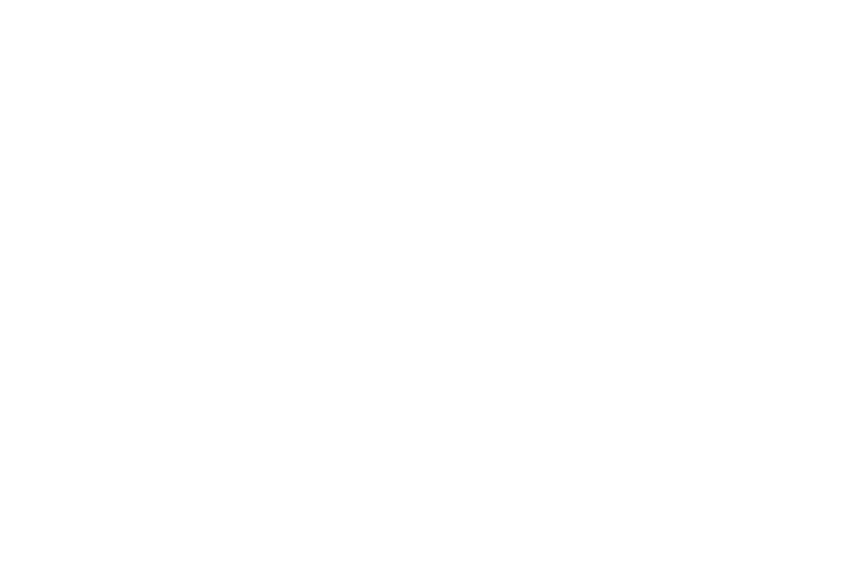

<IPython.core.display.Javascript object>


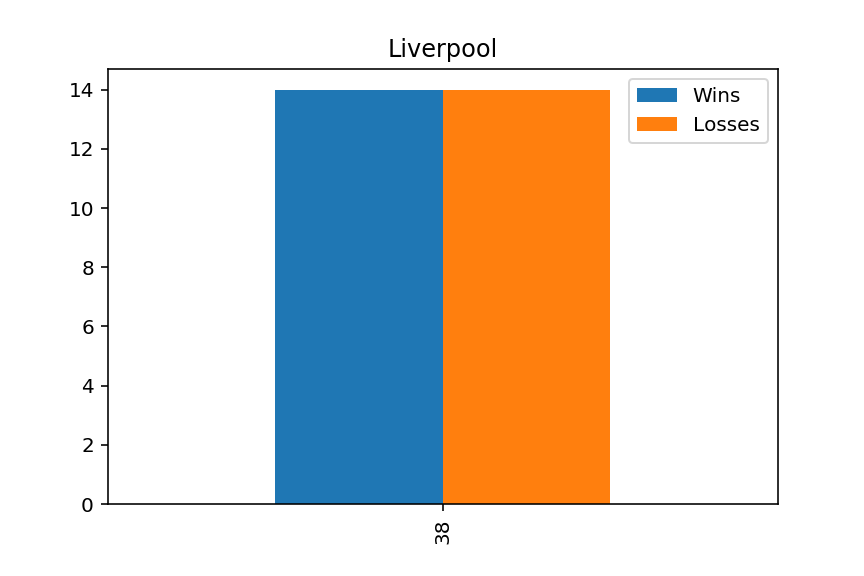

<IPython.core.display.Javascript object>


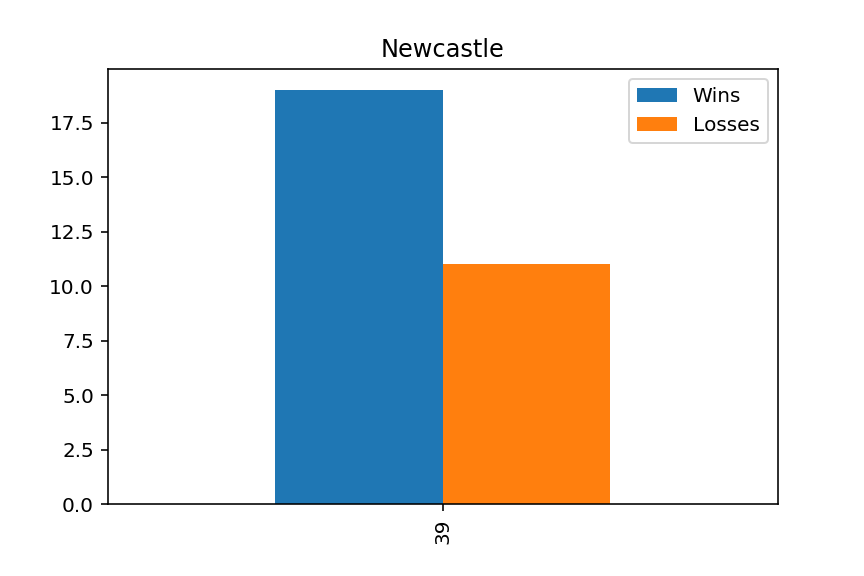

<IPython.core.display.Javascript object>


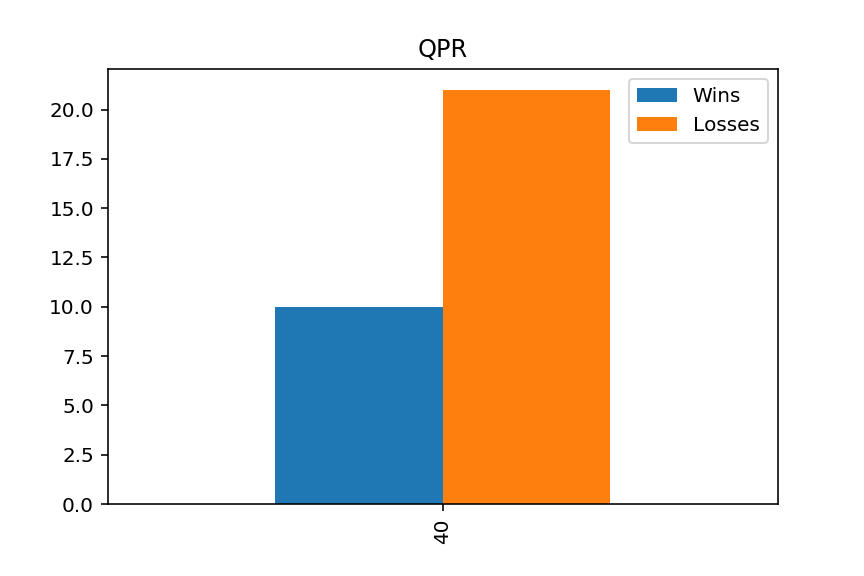

<IPython.core.display.Javascript object>


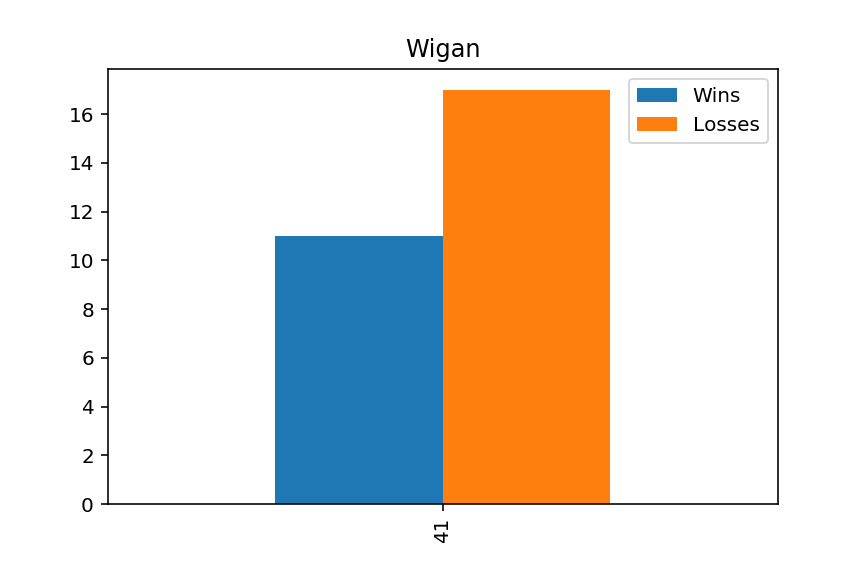

<IPython.core.display.Javascript object>


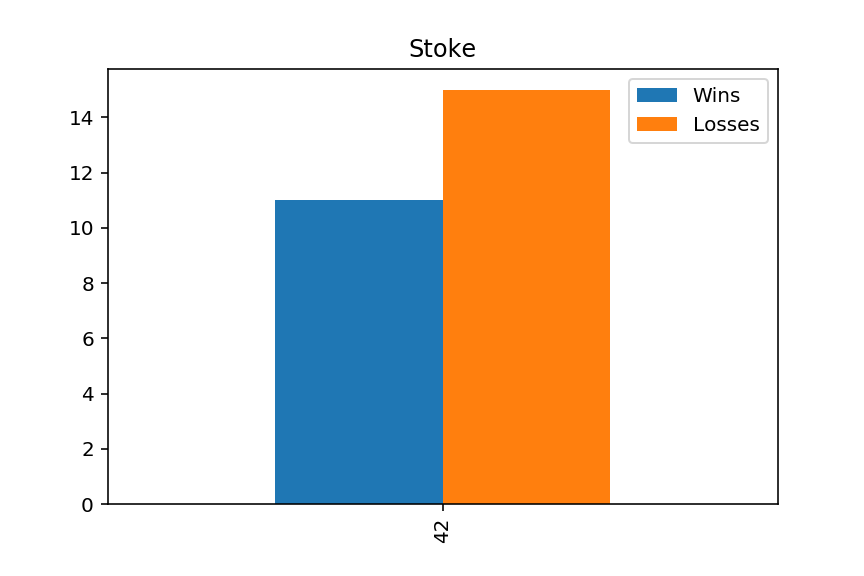

<IPython.core.display.Javascript object>


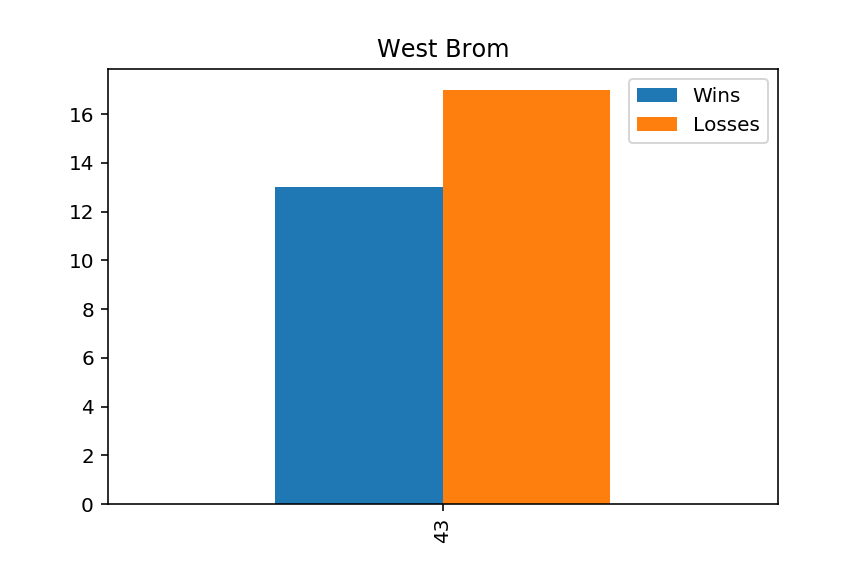

<IPython.core.display.Javascript object>


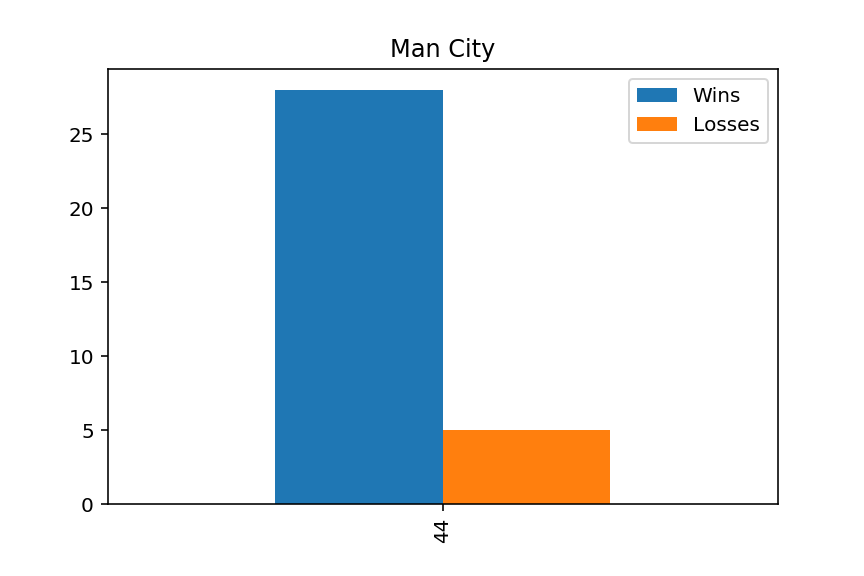

<IPython.core.display.Javascript object>


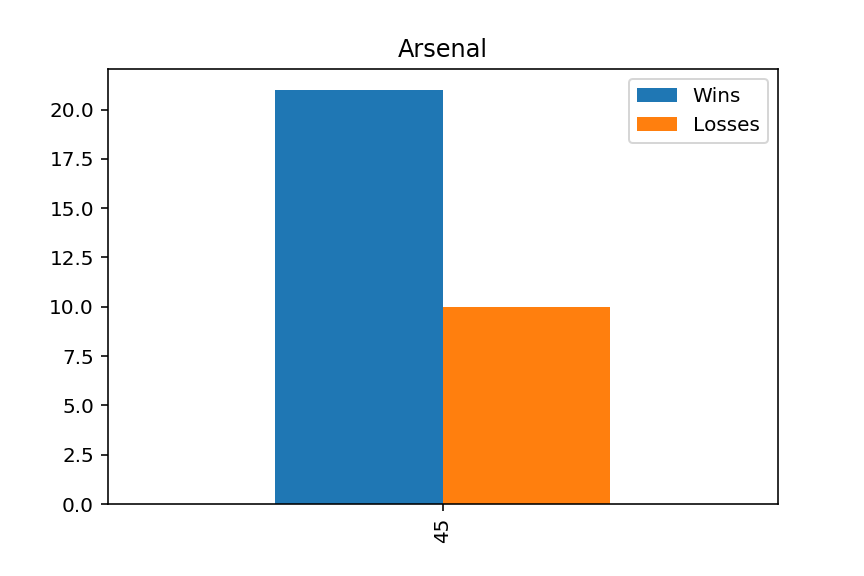

<IPython.core.display.Javascript object>


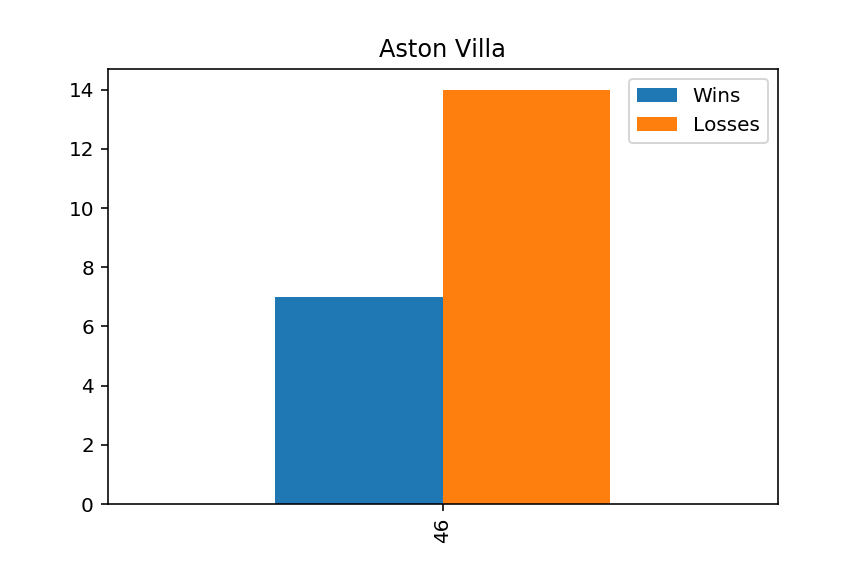

<IPython.core.display.Javascript object>


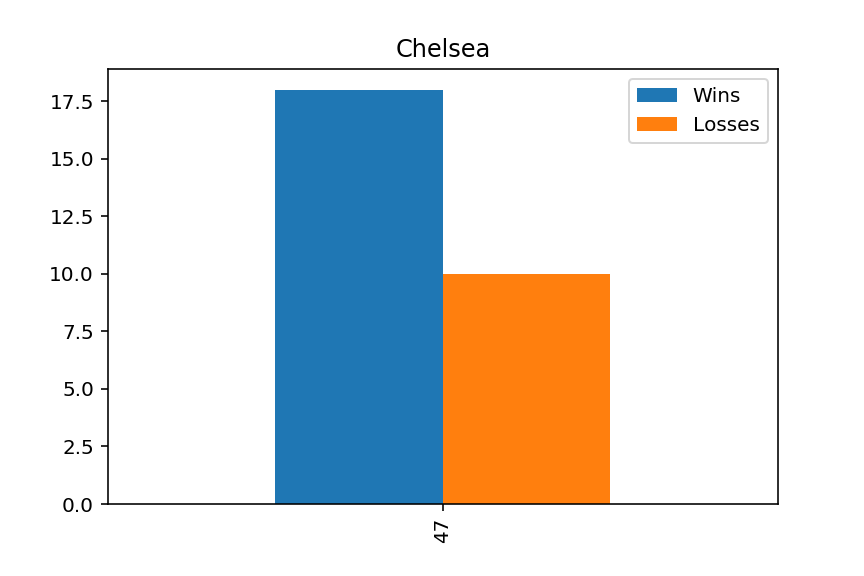

<IPython.core.display.Javascript object>


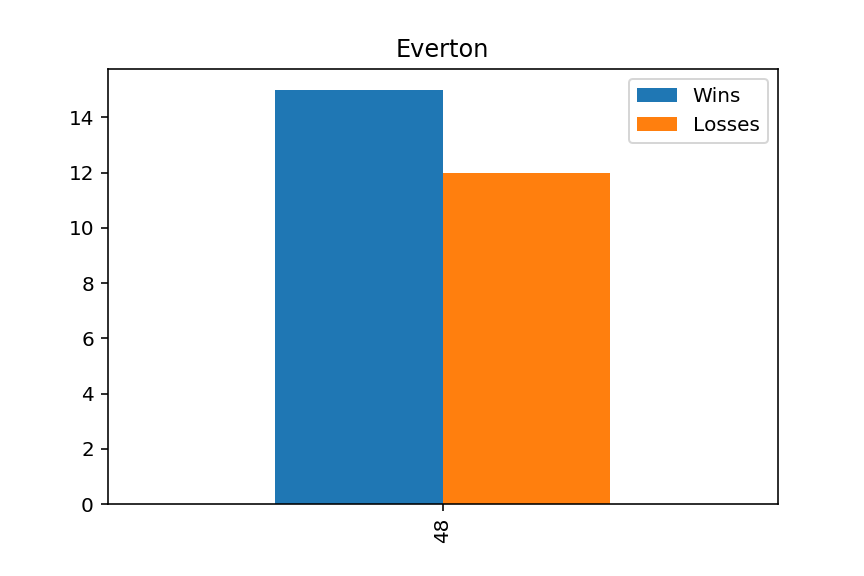

<IPython.core.display.Javascript object>


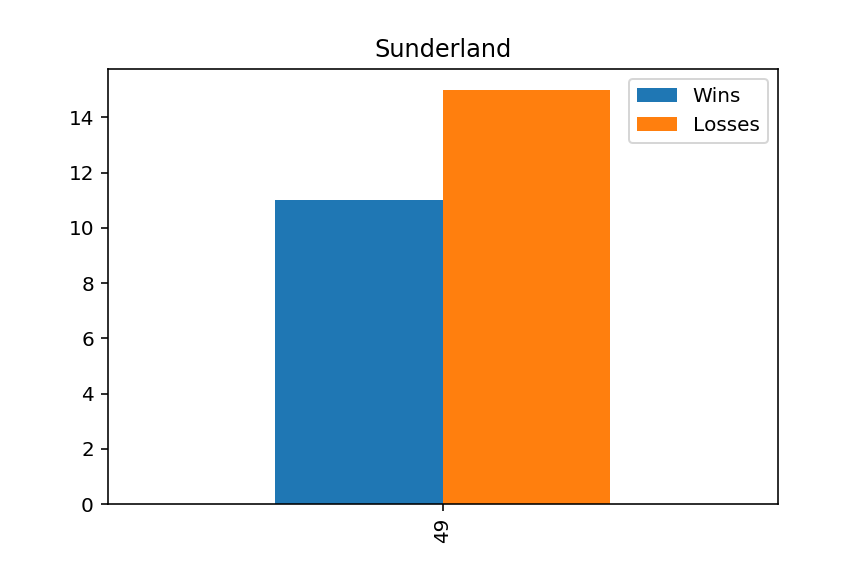

<IPython.core.display.Javascript object>


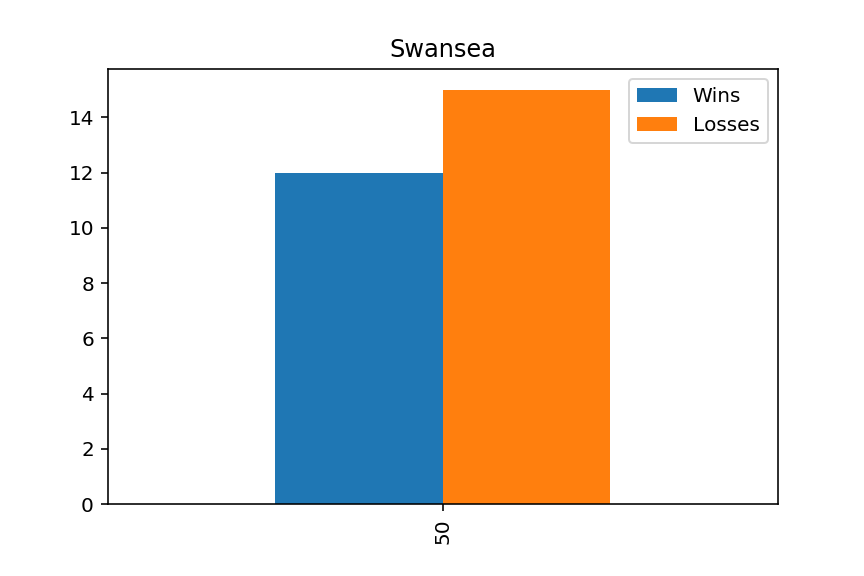

<IPython.core.display.Javascript object>


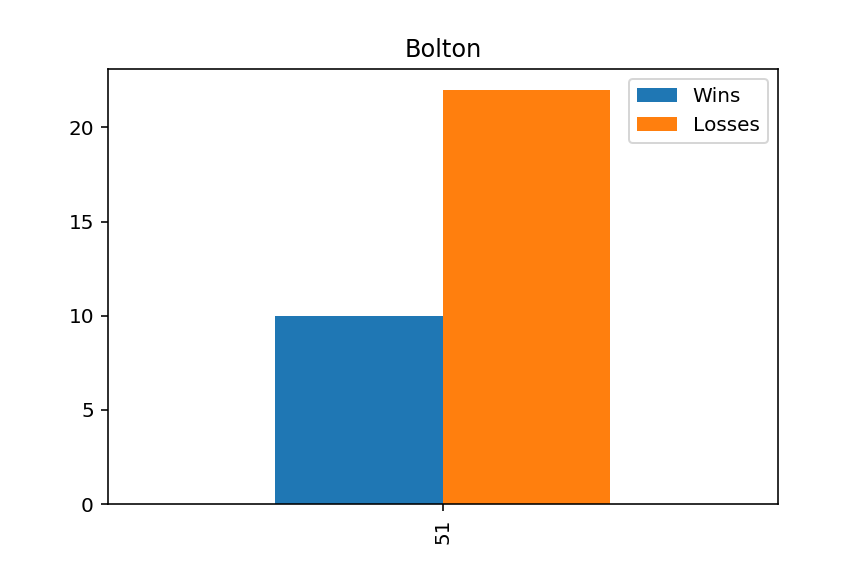

<IPython.core.display.Javascript object>


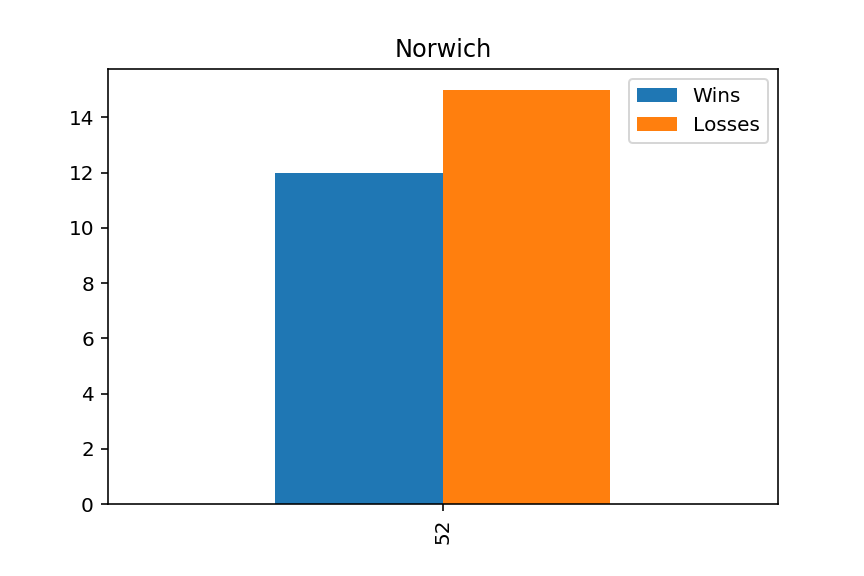

<IPython.core.display.Javascript object>


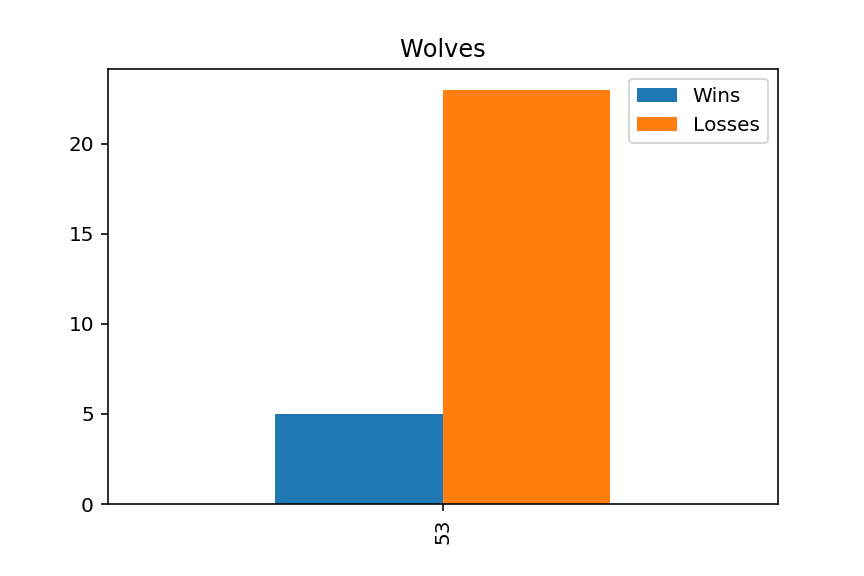

<IPython.core.display.Javascript object>


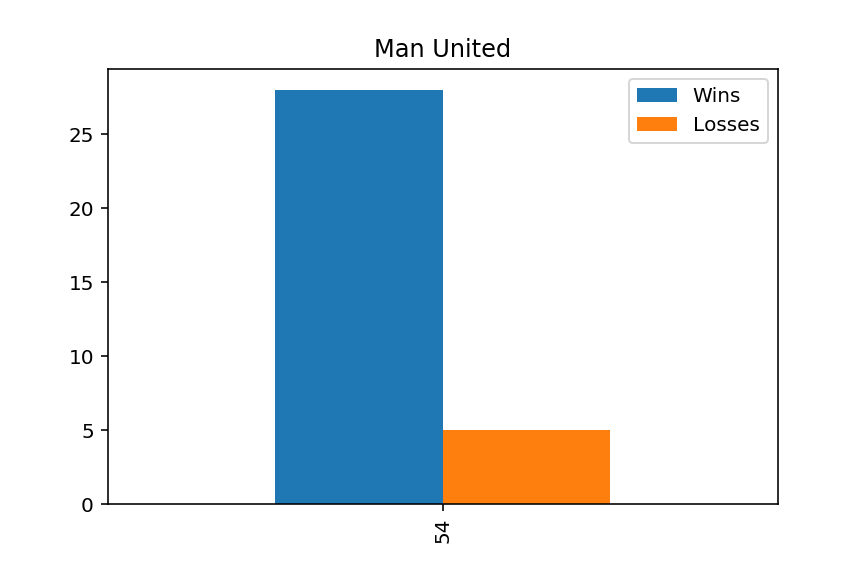

<IPython.core.display.Javascript object>


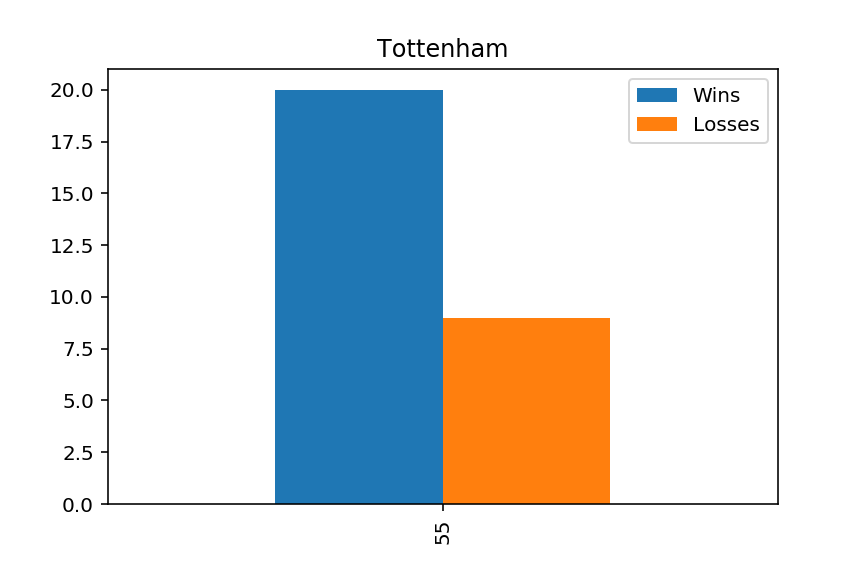

In [202]:
%matplotlib notebook
query = mycollection.find({})
sleep_min = 0
sleep_max = 5

for x in query:
        pickle.loads(x['Charts'])
        time.sleep(random.uniform(sleep_min, sleep_max))

# Loading Images into `DataFrame`

In [150]:
import glob
import random
import base64
import pandas as pd
from PIL import Image
from io import BytesIO
from IPython.display import HTML

In [151]:
pd.set_option('display.max_colwidth', -1)

def get_thumbnail(path):
    i = Image.open(path)
    i.thumbnail((150, 150), Image.LANCZOS)
    return i

def image_base64(im):
    if isinstance(im, str):
        im = get_thumbnail(im)
    with BytesIO() as buffer:
        im.save(buffer, 'jpeg')
        return base64.b64encode(buffer.getvalue()).decode()

def image_formatter(im):
    return f'<img src="data:image/jpeg;base64,{image_base64(im)}">'

In [152]:
df3 = pd.read_csv('df2.csv', index_col=0)
df3['File_Path'] = df3['Team'].map(lambda team: f'{team}.pickle.jpg')
df3['Image'] = df3.File_Path.map(lambda f: get_thumbnail(f))
df3.head(3)

,Team,Goals,Wins,Losses,Draws,Total Games,Wins in Rain,Rain Win Percentage,Graph Name,File_Path,Image
0,Nurnberg,38,12,16,6,17,0.29,29.41%,Nurnberg.pickle,Nurnberg.pickle.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=150x100 at 0x14DAF3208>
1,Stuttgart,63,15,11,8,17,0.18,17.65%,Stuttgart.pickle,Stuttgart.pickle.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=150x100 at 0x14DAF3198>
2,Wolfsburg,47,13,16,5,17,0.24,23.53%,Wolfsburg.pickle,Wolfsburg.pickle.jpg,<PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=150x100 at 0x14DAF30F0>


,Team,Wins,Losses,Image
0,Nurnberg,12,16,
1,Stuttgart,15,11,
2,Wolfsburg,13,16,
3,Mainz,9,13,
4,Freiburg,10,14,
5,M'gladbach,17,8,
6,Hamburg,8,14,
7,Werder Bremen,11,14,
8,Schalke 04,20,10,
9,Hannover,12,10,

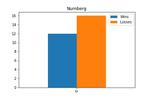
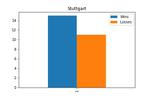
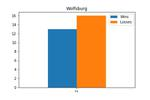
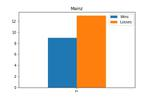
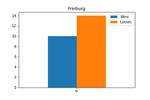
...
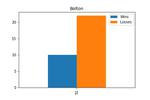
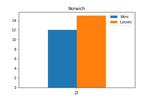
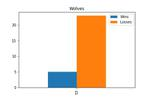
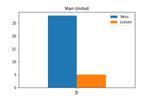
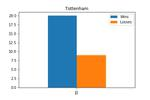

In [153]:
# displaying PIL.Image objects embedded in dataframe
HTML(df3[['Team', 'Wins', 'Losses', 'Image']].to_html(formatters={'Image': image_formatter}, escape=False))

In [ ]:
df3.to_csv('/Users/jacobtadesse/Documents/LearnCo/mod2/s16/dsc-mod-2-lab-online-ds-pt-081219/df2.csv')

# Resources

* Displaying inline images in pandas dataframe: 
https://www.kaggle.com/stassl/displaying-inline-images-in-pandas-dataframe

* Pickle Documentation: https://docs.python.org/3/library/pickle.html

# Me doing the most when all we needed was less:
Create a histogram for each Team's Wins by number of goals scored:

![Not sure why I did the histograms this way at first](Obama.gif "This wasn't required")


# USING a `FOR LOOP` to create a new `DataFrame` (df4) that includes Goals Scored for each Team's Wins, Losses, and Draws

In [213]:
teams_data = []

for team in df['HomeTeam'].unique():
    data = {}
    ## Name
    data['team'] = team
    
    ## Goals per Wins
    gphw = list(df['FTHG'][(df['HomeTeam']==team) & (df['FTR']=='H')])
    gpaw = list(df['FTAG'][(df['AwayTeam']==team) & (df['FTR']=='A')])
    data['Goals_per_Wins'] = gphw + gpaw

    ## Goals per Losses
    gphl = list(df['FTHG'][(df['HomeTeam']==team) & (df['FTR']=='A')])
    gpal = list(df['FTAG'][(df['AwayTeam']==team) & (df['FTR']=='H')])
    data['Goals_per_Losses'] = gphl + gpal

    ## Goals per Draws
    gphd = list(df['FTHG'][(df['HomeTeam']==team) & (df['FTR']=='D')])
    gpad = list(df['FTAG'][(df['AwayTeam']==team) & (df['FTR']=='D')])
    data['Goals_per_Draws'] = gphd+gpad
    
    teams_data.append(data)
           
    
df4 = pd.DataFrame(teams_data)
df4.head(10)

,Goals_per_Draws,Goals_per_Losses,Goals_per_Wins,team
0,"[1, 2, 1, 3, 0, 2]","[0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0]","[2, 1, 4, 2, 1, 1, 2, 1, 3, 3, 2, 1]",Nurnberg
1,"[1, 2, 0, 4, 2, 2, 1, 1]","[1, 1, 0, 0, 0, 1, 1, 0, 0, 2, 0]","[4, 1, 3, 4, 3, 5, 4, 3, 2, 2, 2, 2, 3, 4, 2]",Stuttgart
2,"[2, 0, 0, 1, 0]","[0, 1, 2, 1, 1, 1, 1, 1, 0, 0, 2, 1, 1, 0, 0, 0]","[1, 3, 2, 1, 3, 2, 2, 1, 3, 4, 3, 4, 3]",Wolfsburg
3,"[0, 1, 0, 3, 0, 1, 1, 0, 1, 0, 2, 1]","[1, 2, 1, 1, 0, 0, 0, 1, 0, 2, 1, 1, 1]","[3, 4, 3, 4, 2, 2, 3, 2, 3]",Mainz
4,"[0, 2, 2, 1, 2, 0, 2, 0, 0, 1]","[1, 1, 0, 1, 1, 2, 0, 3, 2, 0, 1, 0, 0, 1]","[4, 2, 2, 3, 1, 1, 3, 2, 2, 2]",Freiburg
5,"[1, 0, 1, 2, 1, 0, 0, 0, 2]","[1, 0, 0, 1, 0, 0, 0, 0]","[3, 3, 1, 1, 3, 5, 2, 1, 4, 2, 3, 2, 1, 1, 3, 2, 3]",M'gladbach
6,"[1, 1, 1, 2, 0, 1, 1, 0, 1, 1, 1, 2]","[1, 3, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0]","[2, 1, 2, 2, 1, 1, 2, 2]",Hamburg
7,"[1, 2, 1, 1, 1, 0, 2, 1, 1]","[1, 0, 0, 2, 0, 0, 2, 0, 1, 1, 0, 1, 0, 0]","[3, 5, 2, 2, 2, 3, 2, 4, 3, 3, 2]",Werder Bremen
8,"[1, 1, 2, 1]","[0, 1, 1, 1, 1, 1, 0, 0, 0, 0]","[5, 4, 3, 2, 4, 3, 5, 3, 4, 4, 1, 3, 3, 4, 3, 2, 1, 4, 2, 4]",Schalke 04
9,"[0, 1, 0, 2, 1, 1, 2, 0, 1, 1, 0, 1]","[1, 1, 0, 0, 0, 0, 1, 0, 1, 0]","[2, 2, 4, 2, 1, 4, 3, 2, 2, 2, 2, 1]",Hannover


### `Saving new DataFrame (df4) as .CSV`

In [216]:
df4.to_csv('/Users/jacobtadesse/Documents/LearnCo/mod2/s16/dsc-mod-2-lab-online-ds-pt-081219/df4.csv')

# USING a `FOR LOOP` to create `Histograms` for Each Team's Wins/Goals Scored and Losses/Goals Scored

In [219]:
%matplotlib inline

team_list = list(df4['team'])
plt.figure(figsize=(32,len(team_list)*9))
k=0
for i,j in enumerate(team_list):
    
    wins = df4['Goals_per_Wins'][df4['team']== j]
    losses = df4['Goals_per_Losses'][df4['team']== j]
    
    ax1 = plt.subplot(len(team_list),2,k+1)
    ax1.hist(wins)
    ax1.set_title("{} Wins per Goals Scored in 2011".format(j),
                 fontweight='bold',
                 size=20)
    ax1.set_ylabel('# of Wins', 
                  fontsize = 20.0) 
    ax1.set_xlabel('# Goals Scored', 
                  fontsize = 20) 
    
    
    ax2 = plt.subplot(len(team_list),2,k+2)
    ax2.hist(losses)
    ax2.set_title("{} Losses per Goals Scored in 2011".format(j),
                  fontweight='bold',
                  size=20)
    ax2.set_ylabel('# of Losses', 
                  fontsize = 20.0) 
    ax2.set_xlabel('# Goals Scored', 
                  fontsize = 20) 

    k +=2

plt.show()